In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

import torch
import torch.nn as nn
import torchvision.transforms as T
from torchvision.datasets import ImageFolder
from torchvision.utils import make_grid
from torch.utils.data import DataLoader, Dataset
import torch.optim as optim
from tqdm import tqdm
import torchvision.utils as vutils
import os
from torchmetrics.image.inception import InceptionScore

device = 'cuda' if torch.cuda.is_available() else 'cpu'


In [2]:
class Discriminator(nn.Module):
    def __init__(self, in_channels, out_channels):             # inchannel = 3, outchannel = 64
        super(Discriminator, self).__init__()
        self.discriminator = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, kernel_size = 4, stride = 2, padding = 1),   #32x32x64
            nn.LeakyReLU(0.2),

            nn.Conv2d(out_channels, out_channels * 2, kernel_size = 4, stride = 2, padding = 1, bias = False),    #16x16x128
            nn.BatchNorm2d(out_channels * 2),
            nn.LeakyReLU(0.2),

            nn.Conv2d(out_channels * 2, out_channels * 4, kernel_size = 4, stride = 2, padding = 1, bias = False),    #8x8x256
            nn.BatchNorm2d(out_channels * 4),
            nn.LeakyReLU(0.2),
            
            nn.Conv2d(out_channels * 4, out_channels * 8, kernel_size = 4, stride = 2, padding = 1, bias = False),    #4x4x512
            nn.BatchNorm2d(out_channels * 8),
            nn.LeakyReLU(0.2),

            nn.Conv2d(out_channels * 8, 1, kernel_size = 4, stride = 1, padding = 0), #1x1x1
            nn.Sigmoid()
        )

    def forward(self, x):
        return self.discriminator(x)
        

In [3]:
class Generator(nn.Module):
    def __init__(self, z_dim, image_size, out_channels):             # image_size = 64, outchannel = 3
        super(Generator, self).__init__()
        self.generator = nn.Sequential(
            self._block(z_dim, image_size * 8, 4, 1, 0),   #4x4x512
            self._block(image_size * 8, image_size * 4, 4, 2, 1), #8x8x256
            self._block(image_size * 4, image_size * 2, 4, 2, 1), #16x16x128
            self._block(image_size * 2, image_size, 4, 2, 1), #32x32x64
            nn.ConvTranspose2d(image_size, out_channels, kernel_size = 4, stride = 2, padding = 1),
            nn.Tanh()
        )
    def _block(self, in_channels, out_channels, kernel_size, stride, padding):
        return nn.Sequential(
            nn.ConvTranspose2d(in_channels, out_channels, kernel_size, stride, padding, bias = False),
            nn.BatchNorm2d(out_channels),
            nn.ReLU()
        )

    def forward(self, z):
        return self.generator(z)

In [4]:
IMG_SIZE = 64
BATCH_SIZE = 64
gen_lr = 0.0002
disc_lr = 0.00008
EPOCHS = 30
z_dim = 100

dir = r'D:\Codes\MLDS\AnimeGAN\anime'

In [5]:
transforms = T.Compose([
    T.Resize((IMG_SIZE, IMG_SIZE)),
    T.ToTensor(),
    T.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
])

In [6]:
dataset = ImageFolder(root = dir, transform = transforms)

In [7]:
dataloader = DataLoader(dataset, batch_size = BATCH_SIZE, shuffle = True)

In [8]:
def show_images(images):
    fig, ax = plt.subplots(figsize=(8, 8))
    ax.set_xticks([]); ax.set_yticks([])
    ax.imshow(make_grid(images.detach(), nrow=8).permute(1, 2, 0))

def show_batch(dataloader):
    for images, _ in dataloader:
        show_images(images)
        break

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


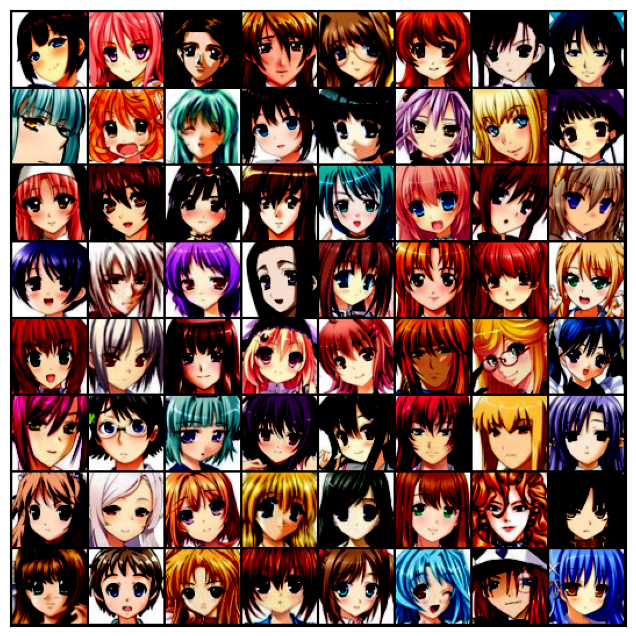

In [9]:
show_batch(dataloader)

In [107]:
gen = Generator(z_dim, IMG_SIZE, 3).to(device)
disc = Discriminator(3, 64).to(device)

In [108]:
gen

Generator(
  (generator): Sequential(
    (0): Sequential(
      (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
      (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU()
    )
    (1): Sequential(
      (0): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU()
    )
    (2): Sequential(
      (0): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU()
    )
    (3): Sequential(
      (0): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU()
    )
    (4): ConvTranspose2d(64, 3, 

In [109]:
loss = nn.BCELoss()
gen_optimizer = optim.Adam(gen.parameters(), lr = gen_lr, betas = (0.5, 0.999))
disc_optimizer = optim.Adam(disc.parameters(), lr = disc_lr, betas = (0.5, 0.999))

fixed_noise = torch.randn(16, z_dim, 1, 1, device = device)

  0%|▏                                                                                 | 3/993 [00:00<02:36,  6.34it/s]

Epoch: 0 	 Disc_Loss: 0.6572572588920593 	 gen_Loss: 1.2614295482635498


 10%|████████▎                                                                       | 103/993 [00:09<01:17, 11.52it/s]

Epoch: 0 	 Disc_Loss: 0.6035700440406799 	 gen_Loss: 3.5081968307495117


 20%|████████████████▎                                                               | 203/993 [00:17<01:08, 11.52it/s]

Epoch: 0 	 Disc_Loss: 0.613228976726532 	 gen_Loss: 4.457393169403076


 31%|████████████████████████▍                                                       | 303/993 [00:26<01:00, 11.50it/s]

Epoch: 0 	 Disc_Loss: 0.5868966579437256 	 gen_Loss: 2.893050193786621


 41%|████████████████████████████████▍                                               | 403/993 [00:34<00:51, 11.51it/s]

Epoch: 0 	 Disc_Loss: 0.5282173156738281 	 gen_Loss: 2.5397825241088867


 51%|████████████████████████████████████████▌                                       | 503/993 [00:43<00:42, 11.58it/s]

Epoch: 0 	 Disc_Loss: 0.5616724491119385 	 gen_Loss: 2.2133917808532715


 61%|████████████████████████████████████████████████▌                               | 603/993 [00:51<00:34, 11.32it/s]

Epoch: 0 	 Disc_Loss: 0.564312756061554 	 gen_Loss: 1.667305827140808


 71%|████████████████████████████████████████████████████████▋                       | 703/993 [01:00<00:25, 11.55it/s]

Epoch: 0 	 Disc_Loss: 0.6658069491386414 	 gen_Loss: 2.8091564178466797


 81%|████████████████████████████████████████████████████████████████▋               | 803/993 [01:08<00:16, 11.54it/s]

Epoch: 0 	 Disc_Loss: 0.36263829469680786 	 gen_Loss: 3.332559108734131


 91%|████████████████████████████████████████████████████████████████████████▋       | 903/993 [01:17<00:07, 11.49it/s]

Epoch: 0 	 Disc_Loss: 0.42401713132858276 	 gen_Loss: 2.3899083137512207


100%|████████████████████████████████████████████████████████████████████████████████| 993/993 [01:24<00:00, 11.73it/s]


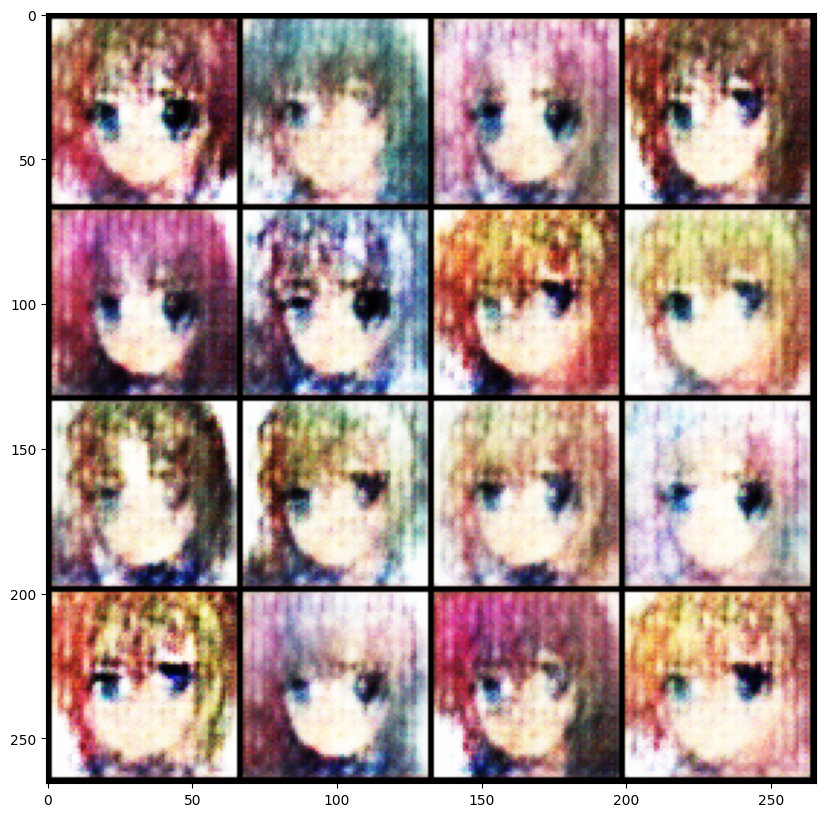

  0%|▏                                                                                 | 3/993 [00:00<01:35, 10.41it/s]

Epoch: 1 	 Disc_Loss: 0.5159602165222168 	 gen_Loss: 3.8165371417999268


 10%|████████▎                                                                       | 103/993 [00:08<01:16, 11.60it/s]

Epoch: 1 	 Disc_Loss: 0.5327522158622742 	 gen_Loss: 2.6520228385925293


 20%|████████████████▎                                                               | 203/993 [00:17<01:08, 11.48it/s]

Epoch: 1 	 Disc_Loss: 0.33810311555862427 	 gen_Loss: 2.3223109245300293


 31%|████████████████████████▍                                                       | 303/993 [00:25<00:59, 11.67it/s]

Epoch: 1 	 Disc_Loss: 0.48700186610221863 	 gen_Loss: 2.033586025238037


 41%|████████████████████████████████▍                                               | 403/993 [00:34<00:50, 11.66it/s]

Epoch: 1 	 Disc_Loss: 0.4638080596923828 	 gen_Loss: 1.8767482042312622


 51%|████████████████████████████████████████▌                                       | 503/993 [00:42<00:41, 11.68it/s]

Epoch: 1 	 Disc_Loss: 0.5035876631736755 	 gen_Loss: 2.7914204597473145


 61%|████████████████████████████████████████████████▌                               | 603/993 [00:51<00:33, 11.54it/s]

Epoch: 1 	 Disc_Loss: 0.4978036880493164 	 gen_Loss: 3.329367160797119


 71%|████████████████████████████████████████████████████████▋                       | 703/993 [00:59<00:25, 11.32it/s]

Epoch: 1 	 Disc_Loss: 0.3758721649646759 	 gen_Loss: 2.4774889945983887


 81%|████████████████████████████████████████████████████████████████▋               | 803/993 [01:07<00:16, 11.60it/s]

Epoch: 1 	 Disc_Loss: 0.4570075571537018 	 gen_Loss: 3.390467405319214


 91%|████████████████████████████████████████████████████████████████████████▋       | 903/993 [01:16<00:07, 11.53it/s]

Epoch: 1 	 Disc_Loss: 0.37749379873275757 	 gen_Loss: 2.6155009269714355


100%|████████████████████████████████████████████████████████████████████████████████| 993/993 [01:23<00:00, 11.83it/s]


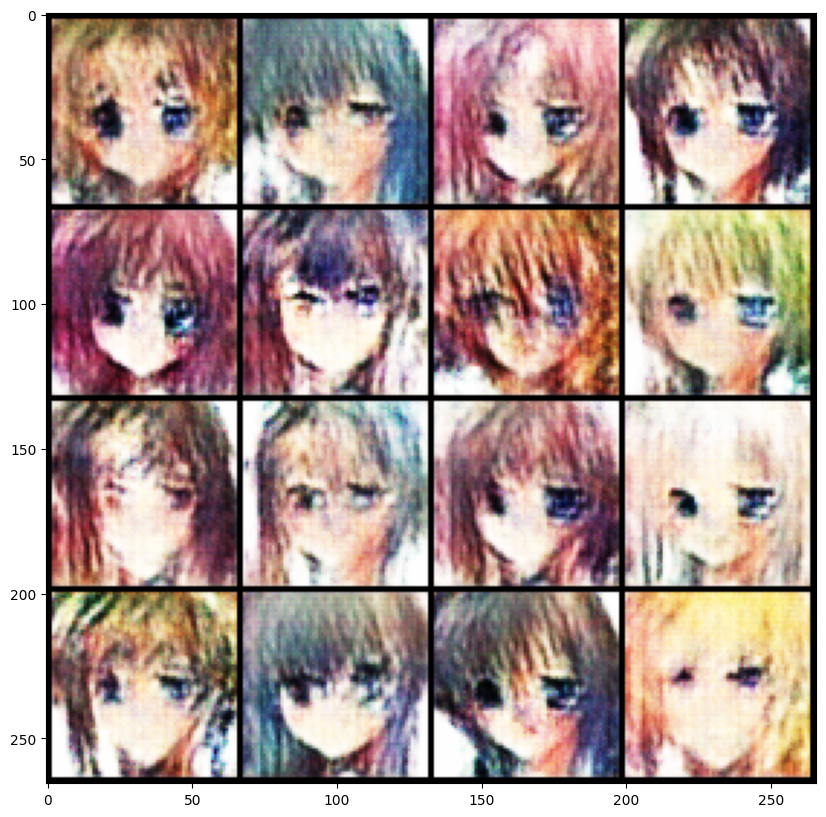

  0%|▏                                                                                 | 3/993 [00:00<01:36, 10.24it/s]

Epoch: 2 	 Disc_Loss: 0.2950274348258972 	 gen_Loss: 2.820160388946533


 10%|████████▎                                                                       | 103/993 [00:08<01:15, 11.81it/s]

Epoch: 2 	 Disc_Loss: 0.2993279695510864 	 gen_Loss: 3.1261234283447266


 20%|████████████████▎                                                               | 203/993 [00:16<01:06, 11.84it/s]

Epoch: 2 	 Disc_Loss: 0.41336527466773987 	 gen_Loss: 2.184345245361328


 31%|████████████████████████▍                                                       | 303/993 [00:25<00:59, 11.64it/s]

Epoch: 2 	 Disc_Loss: 0.4631785452365875 	 gen_Loss: 2.256197452545166


 41%|████████████████████████████████▍                                               | 403/993 [00:33<00:50, 11.72it/s]

Epoch: 2 	 Disc_Loss: 0.33884716033935547 	 gen_Loss: 3.2533793449401855


 51%|████████████████████████████████████████▌                                       | 503/993 [00:41<00:41, 11.73it/s]

Epoch: 2 	 Disc_Loss: 0.32002851366996765 	 gen_Loss: 2.238046884536743


 61%|████████████████████████████████████████████████▌                               | 603/993 [00:50<00:33, 11.70it/s]

Epoch: 2 	 Disc_Loss: 0.4248669445514679 	 gen_Loss: 3.153231143951416


 71%|████████████████████████████████████████████████████████▋                       | 703/993 [00:58<00:24, 11.75it/s]

Epoch: 2 	 Disc_Loss: 0.31479135155677795 	 gen_Loss: 1.981503963470459


 81%|████████████████████████████████████████████████████████████████▋               | 803/993 [01:06<00:16, 11.72it/s]

Epoch: 2 	 Disc_Loss: 0.312608927488327 	 gen_Loss: 2.7548789978027344


 91%|████████████████████████████████████████████████████████████████████████▋       | 903/993 [01:15<00:07, 11.66it/s]

Epoch: 2 	 Disc_Loss: 0.3347563147544861 	 gen_Loss: 2.6943576335906982


100%|████████████████████████████████████████████████████████████████████████████████| 993/993 [01:22<00:00, 12.02it/s]


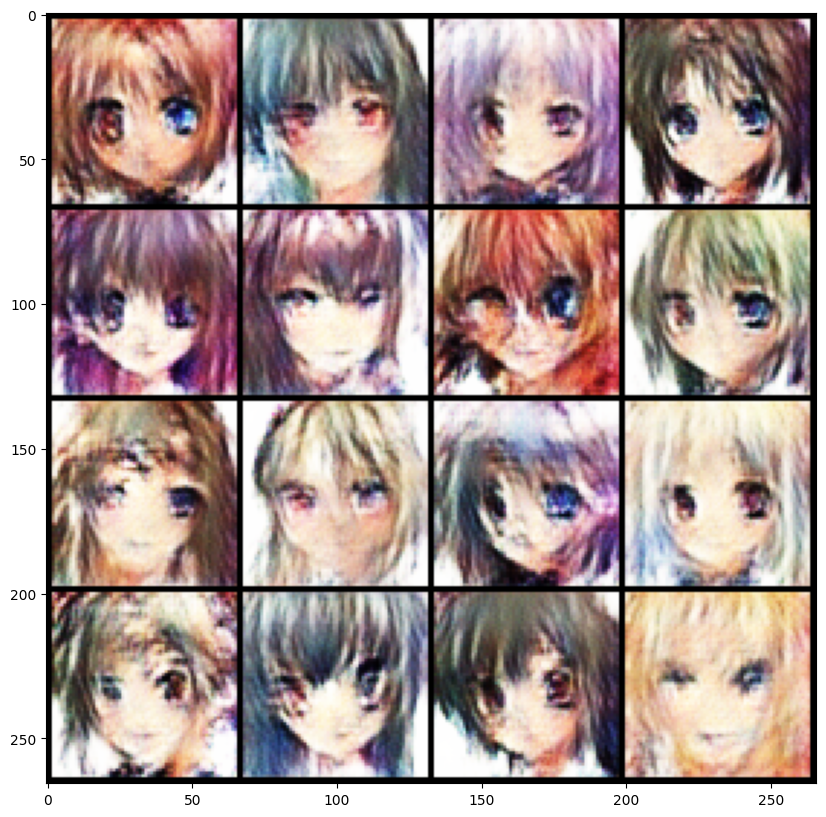

  0%|▏                                                                                 | 3/993 [00:00<01:30, 10.90it/s]

Epoch: 3 	 Disc_Loss: 0.4713384211063385 	 gen_Loss: 3.927166223526001


 10%|████████▎                                                                       | 103/993 [00:08<01:15, 11.78it/s]

Epoch: 3 	 Disc_Loss: 0.34289470314979553 	 gen_Loss: 1.4960932731628418


 20%|████████████████▎                                                               | 203/993 [00:16<01:07, 11.76it/s]

Epoch: 3 	 Disc_Loss: 0.3576570153236389 	 gen_Loss: 2.358593702316284


 31%|████████████████████████▍                                                       | 303/993 [00:25<00:58, 11.79it/s]

Epoch: 3 	 Disc_Loss: 0.3231176435947418 	 gen_Loss: 3.4152660369873047


 41%|████████████████████████████████▍                                               | 403/993 [00:33<00:50, 11.78it/s]

Epoch: 3 	 Disc_Loss: 0.3831470012664795 	 gen_Loss: 2.2903430461883545


 51%|████████████████████████████████████████▌                                       | 503/993 [00:41<00:41, 11.72it/s]

Epoch: 3 	 Disc_Loss: 0.3701956272125244 	 gen_Loss: 1.8799872398376465


 61%|████████████████████████████████████████████████▌                               | 603/993 [00:50<00:33, 11.79it/s]

Epoch: 3 	 Disc_Loss: 0.43755200505256653 	 gen_Loss: 1.7197391986846924


 71%|████████████████████████████████████████████████████████▋                       | 703/993 [00:58<00:24, 11.72it/s]

Epoch: 3 	 Disc_Loss: 0.33281707763671875 	 gen_Loss: 2.511295795440674


 81%|████████████████████████████████████████████████████████████████▋               | 803/993 [01:06<00:16, 11.68it/s]

Epoch: 3 	 Disc_Loss: 0.31133028864860535 	 gen_Loss: 1.9429290294647217


 91%|████████████████████████████████████████████████████████████████████████▋       | 903/993 [01:15<00:07, 11.78it/s]

Epoch: 3 	 Disc_Loss: 0.42131027579307556 	 gen_Loss: 3.3915634155273438


100%|████████████████████████████████████████████████████████████████████████████████| 993/993 [01:22<00:00, 12.03it/s]


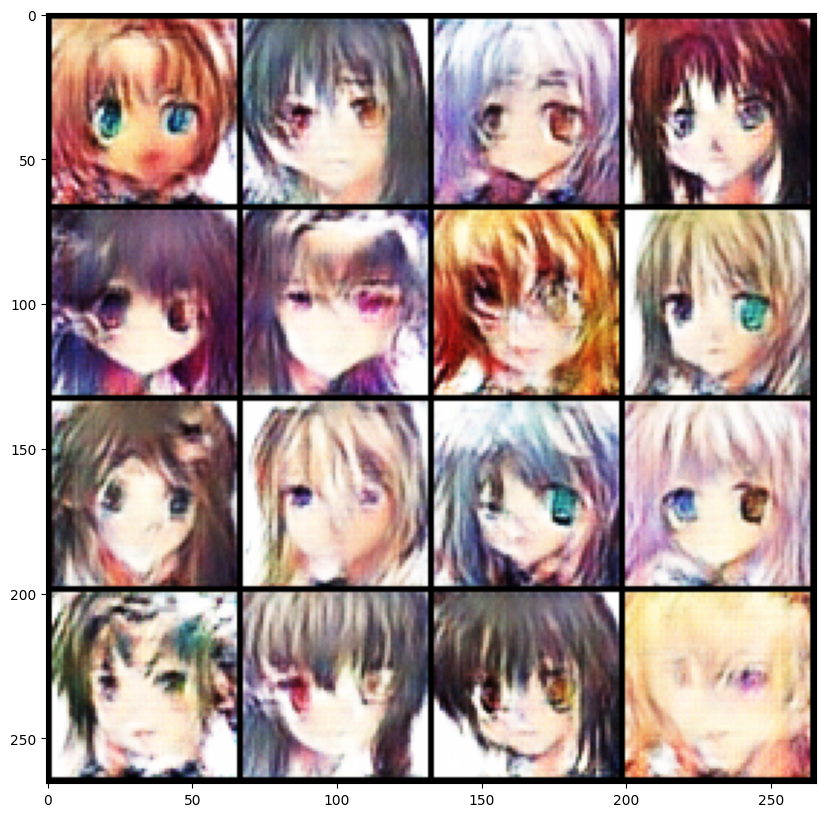

  0%|▏                                                                                 | 3/993 [00:00<01:29, 11.10it/s]

Epoch: 4 	 Disc_Loss: 0.46214738488197327 	 gen_Loss: 1.1847656965255737


 10%|████████▎                                                                       | 103/993 [00:08<01:15, 11.72it/s]

Epoch: 4 	 Disc_Loss: 0.35584545135498047 	 gen_Loss: 2.388339042663574


 20%|████████████████▎                                                               | 203/993 [00:17<01:08, 11.58it/s]

Epoch: 4 	 Disc_Loss: 0.4090215265750885 	 gen_Loss: 3.8773720264434814


 31%|████████████████████████▍                                                       | 303/993 [00:25<00:58, 11.75it/s]

Epoch: 4 	 Disc_Loss: 0.334442138671875 	 gen_Loss: 2.1046204566955566


 41%|████████████████████████████████▍                                               | 403/993 [00:33<00:50, 11.80it/s]

Epoch: 4 	 Disc_Loss: 0.45999419689178467 	 gen_Loss: 1.0258681774139404


 51%|████████████████████████████████████████▌                                       | 503/993 [00:42<00:41, 11.76it/s]

Epoch: 4 	 Disc_Loss: 0.5160280466079712 	 gen_Loss: 1.857022762298584


 61%|████████████████████████████████████████████████▌                               | 603/993 [00:50<00:33, 11.48it/s]

Epoch: 4 	 Disc_Loss: 0.2742334008216858 	 gen_Loss: 1.899016261100769


 71%|████████████████████████████████████████████████████████▋                       | 703/993 [00:58<00:24, 11.64it/s]

Epoch: 4 	 Disc_Loss: 0.3704698979854584 	 gen_Loss: 1.3942707777023315


 81%|████████████████████████████████████████████████████████████████▋               | 803/993 [01:07<00:16, 11.58it/s]

Epoch: 4 	 Disc_Loss: 0.30349278450012207 	 gen_Loss: 2.3017001152038574


 91%|████████████████████████████████████████████████████████████████████████▋       | 903/993 [01:15<00:07, 11.75it/s]

Epoch: 4 	 Disc_Loss: 0.37946581840515137 	 gen_Loss: 3.0431323051452637


100%|████████████████████████████████████████████████████████████████████████████████| 993/993 [01:23<00:00, 11.96it/s]


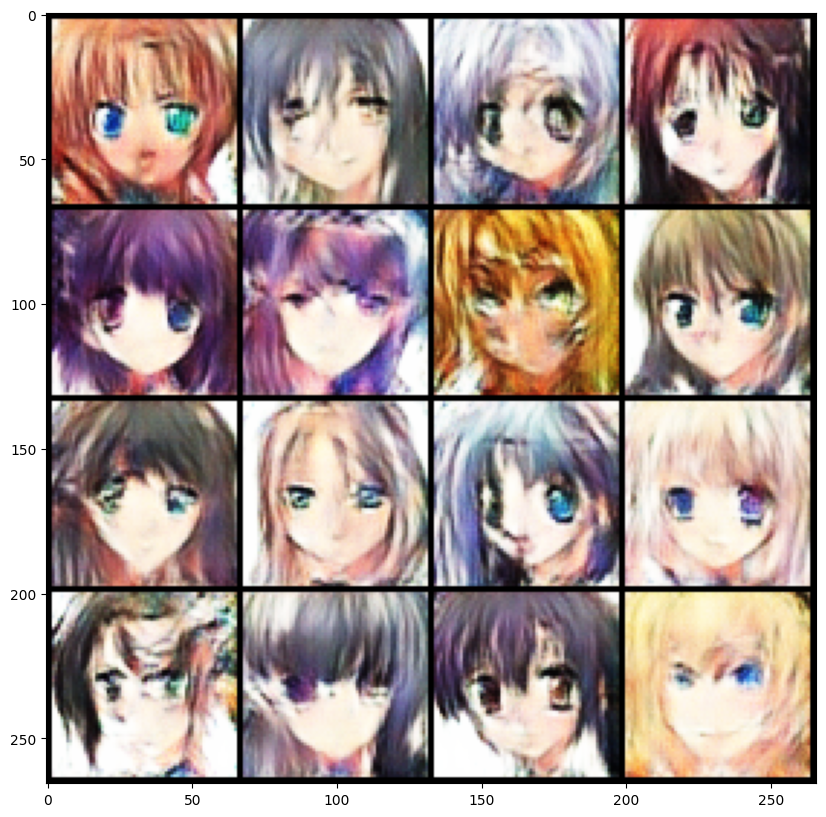

  0%|▏                                                                                 | 3/993 [00:00<01:28, 11.13it/s]

Epoch: 5 	 Disc_Loss: 0.40364107489585876 	 gen_Loss: 1.363527536392212


 10%|████████▎                                                                       | 103/993 [00:08<01:15, 11.73it/s]

Epoch: 5 	 Disc_Loss: 0.3770727217197418 	 gen_Loss: 3.6860787868499756


 20%|████████████████▎                                                               | 203/993 [00:16<01:07, 11.65it/s]

Epoch: 5 	 Disc_Loss: 0.39877381920814514 	 gen_Loss: 3.0048890113830566


 31%|████████████████████████▍                                                       | 303/993 [00:25<00:59, 11.65it/s]

Epoch: 5 	 Disc_Loss: 0.3046024739742279 	 gen_Loss: 2.1158719062805176


 41%|████████████████████████████████▍                                               | 403/993 [00:33<00:50, 11.66it/s]

Epoch: 5 	 Disc_Loss: 0.25422215461730957 	 gen_Loss: 2.138660192489624


 51%|████████████████████████████████████████▌                                       | 503/993 [00:41<00:41, 11.70it/s]

Epoch: 5 	 Disc_Loss: 0.31067997217178345 	 gen_Loss: 2.2331957817077637


 61%|████████████████████████████████████████████████▌                               | 603/993 [00:50<00:33, 11.73it/s]

Epoch: 5 	 Disc_Loss: 0.3905038833618164 	 gen_Loss: 3.926483154296875


 71%|████████████████████████████████████████████████████████▋                       | 703/993 [00:58<00:24, 11.74it/s]

Epoch: 5 	 Disc_Loss: 0.2589166760444641 	 gen_Loss: 2.799516201019287


 81%|████████████████████████████████████████████████████████████████▌               | 801/993 [01:06<00:17, 10.70it/s]

Epoch: 5 	 Disc_Loss: 0.30536097288131714 	 gen_Loss: 1.5639337301254272


 91%|████████████████████████████████████████████████████████████████████████▌       | 901/993 [01:40<00:33,  2.75it/s]

Epoch: 5 	 Disc_Loss: 0.33393239974975586 	 gen_Loss: 1.1947728395462036


100%|████████████████████████████████████████████████████████████████████████████████| 993/993 [02:09<00:00,  7.69it/s]


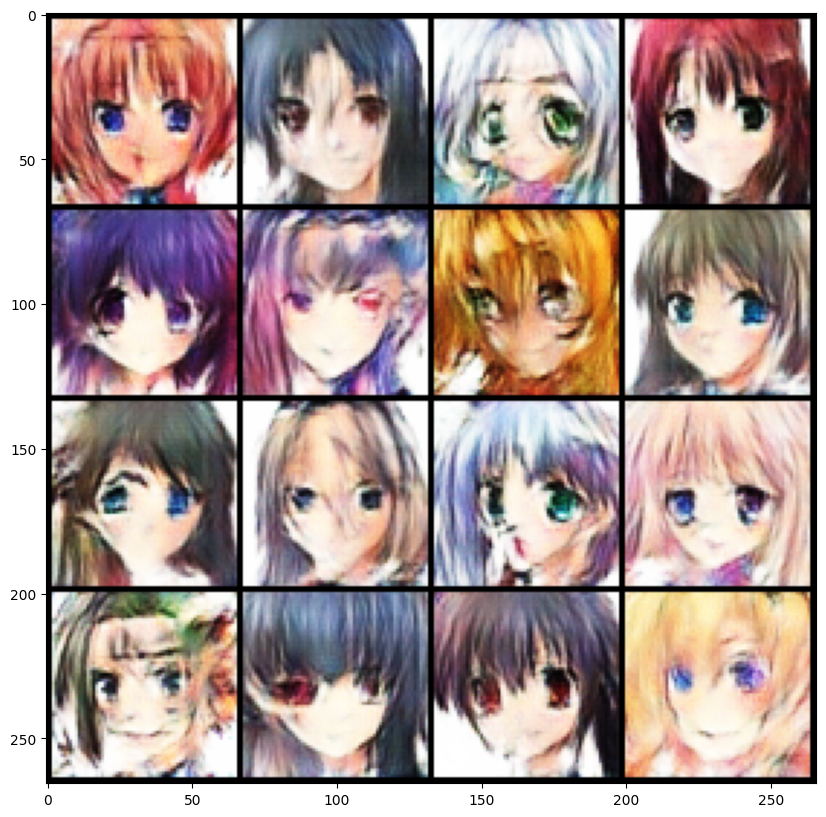

  0%|                                                                                  | 1/993 [00:00<05:02,  3.28it/s]

Epoch: 6 	 Disc_Loss: 0.37368494272232056 	 gen_Loss: 3.252983570098877


 10%|████████▏                                                                       | 101/993 [00:29<04:22,  3.40it/s]

Epoch: 6 	 Disc_Loss: 0.36380264163017273 	 gen_Loss: 3.1592698097229004


 20%|████████████████▏                                                               | 201/993 [00:58<03:52,  3.41it/s]

Epoch: 6 	 Disc_Loss: 0.238660529255867 	 gen_Loss: 3.538961887359619


 30%|████████████████████████▏                                                       | 301/993 [01:26<03:19,  3.47it/s]

Epoch: 6 	 Disc_Loss: 0.26822754740715027 	 gen_Loss: 2.0349249839782715


 40%|████████████████████████████████▎                                               | 401/993 [01:55<02:52,  3.43it/s]

Epoch: 6 	 Disc_Loss: 0.2326420694589615 	 gen_Loss: 2.339768886566162


 50%|████████████████████████████████████████▎                                       | 501/993 [02:23<02:24,  3.40it/s]

Epoch: 6 	 Disc_Loss: 0.225294828414917 	 gen_Loss: 2.26588773727417


 61%|████████████████████████████████████████████████▍                               | 601/993 [02:51<01:55,  3.38it/s]

Epoch: 6 	 Disc_Loss: 0.31149399280548096 	 gen_Loss: 3.395979404449463


 71%|████████████████████████████████████████████████████████▍                       | 701/993 [03:20<01:23,  3.50it/s]

Epoch: 6 	 Disc_Loss: 0.4818095266819 	 gen_Loss: 3.853203296661377


 81%|████████████████████████████████████████████████████████████████▌               | 801/993 [03:49<00:55,  3.43it/s]

Epoch: 6 	 Disc_Loss: 0.19248992204666138 	 gen_Loss: 2.045219659805298


 91%|████████████████████████████████████████████████████████████████████████▌       | 901/993 [04:18<00:26,  3.50it/s]

Epoch: 6 	 Disc_Loss: 0.32485753297805786 	 gen_Loss: 1.529378890991211


100%|████████████████████████████████████████████████████████████████████████████████| 993/993 [04:43<00:00,  3.50it/s]


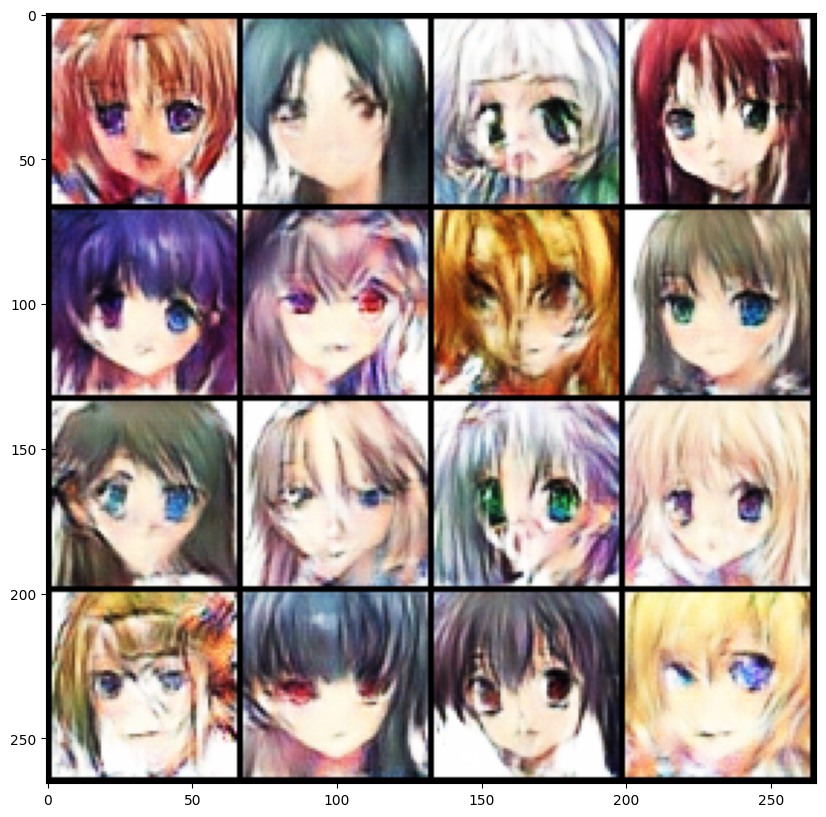

  0%|▏                                                                                 | 3/993 [00:00<01:38, 10.03it/s]

Epoch: 7 	 Disc_Loss: 0.3803773522377014 	 gen_Loss: 1.7001370191574097


 10%|████████▎                                                                       | 103/993 [00:08<01:16, 11.64it/s]

Epoch: 7 	 Disc_Loss: 0.20029157400131226 	 gen_Loss: 2.431060314178467


 20%|████████████████▎                                                               | 203/993 [00:16<01:07, 11.77it/s]

Epoch: 7 	 Disc_Loss: 0.15023532509803772 	 gen_Loss: 2.8634700775146484


 31%|████████████████████████▍                                                       | 303/993 [00:25<00:58, 11.72it/s]

Epoch: 7 	 Disc_Loss: 0.20183786749839783 	 gen_Loss: 2.8056931495666504


 41%|████████████████████████████████▍                                               | 403/993 [00:33<00:51, 11.54it/s]

Epoch: 7 	 Disc_Loss: 0.2567858397960663 	 gen_Loss: 2.00140643119812


 51%|████████████████████████████████████████▌                                       | 503/993 [00:41<00:41, 11.78it/s]

Epoch: 7 	 Disc_Loss: 0.1452401876449585 	 gen_Loss: 3.1516828536987305


 61%|████████████████████████████████████████████████▌                               | 603/993 [00:50<00:32, 11.84it/s]

Epoch: 7 	 Disc_Loss: 0.8238455057144165 	 gen_Loss: 1.4169628620147705


 71%|████████████████████████████████████████████████████████▋                       | 703/993 [00:58<00:24, 11.81it/s]

Epoch: 7 	 Disc_Loss: 0.20552487671375275 	 gen_Loss: 2.142191171646118


 81%|████████████████████████████████████████████████████████████████▋               | 803/993 [01:06<00:16, 11.70it/s]

Epoch: 7 	 Disc_Loss: 0.2271237075328827 	 gen_Loss: 1.5777146816253662


 91%|████████████████████████████████████████████████████████████████████████▋       | 903/993 [01:15<00:07, 11.63it/s]

Epoch: 7 	 Disc_Loss: 0.3526076674461365 	 gen_Loss: 2.0926787853240967


100%|████████████████████████████████████████████████████████████████████████████████| 993/993 [01:22<00:00, 12.01it/s]


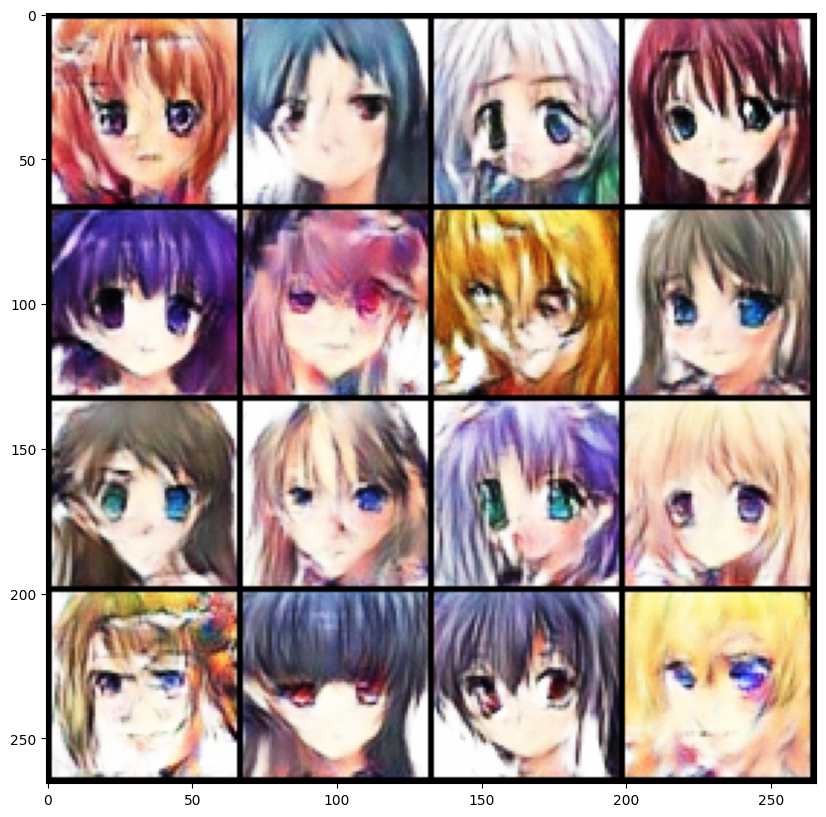

  0%|▏                                                                                 | 3/993 [00:00<01:29, 11.05it/s]

Epoch: 8 	 Disc_Loss: 1.0419738292694092 	 gen_Loss: 6.457467079162598


 10%|████████▎                                                                       | 103/993 [00:08<01:16, 11.68it/s]

Epoch: 8 	 Disc_Loss: 0.2240973263978958 	 gen_Loss: 2.4677200317382812


 20%|████████████████▎                                                               | 203/993 [00:16<01:07, 11.78it/s]

Epoch: 8 	 Disc_Loss: 0.26596716046333313 	 gen_Loss: 2.528097629547119


 31%|████████████████████████▍                                                       | 303/993 [00:25<00:58, 11.74it/s]

Epoch: 8 	 Disc_Loss: 0.20476604998111725 	 gen_Loss: 2.486851215362549


 41%|████████████████████████████████▍                                               | 403/993 [00:33<00:50, 11.57it/s]

Epoch: 8 	 Disc_Loss: 0.22800134122371674 	 gen_Loss: 3.73331880569458


 51%|████████████████████████████████████████▌                                       | 503/993 [00:41<00:41, 11.72it/s]

Epoch: 8 	 Disc_Loss: 0.2524234354496002 	 gen_Loss: 4.1945953369140625


 61%|████████████████████████████████████████████████▌                               | 603/993 [00:50<00:33, 11.80it/s]

Epoch: 8 	 Disc_Loss: 0.14468130469322205 	 gen_Loss: 2.71356201171875


 71%|████████████████████████████████████████████████████████▋                       | 703/993 [00:58<00:24, 11.73it/s]

Epoch: 8 	 Disc_Loss: 0.1762160062789917 	 gen_Loss: 2.4566097259521484


 81%|████████████████████████████████████████████████████████████████▋               | 803/993 [01:06<00:16, 11.70it/s]

Epoch: 8 	 Disc_Loss: 0.40729114413261414 	 gen_Loss: 4.860806465148926


 91%|████████████████████████████████████████████████████████████████████████▋       | 903/993 [01:15<00:07, 11.72it/s]

Epoch: 8 	 Disc_Loss: 0.14660003781318665 	 gen_Loss: 2.7781519889831543


100%|████████████████████████████████████████████████████████████████████████████████| 993/993 [01:22<00:00, 12.02it/s]


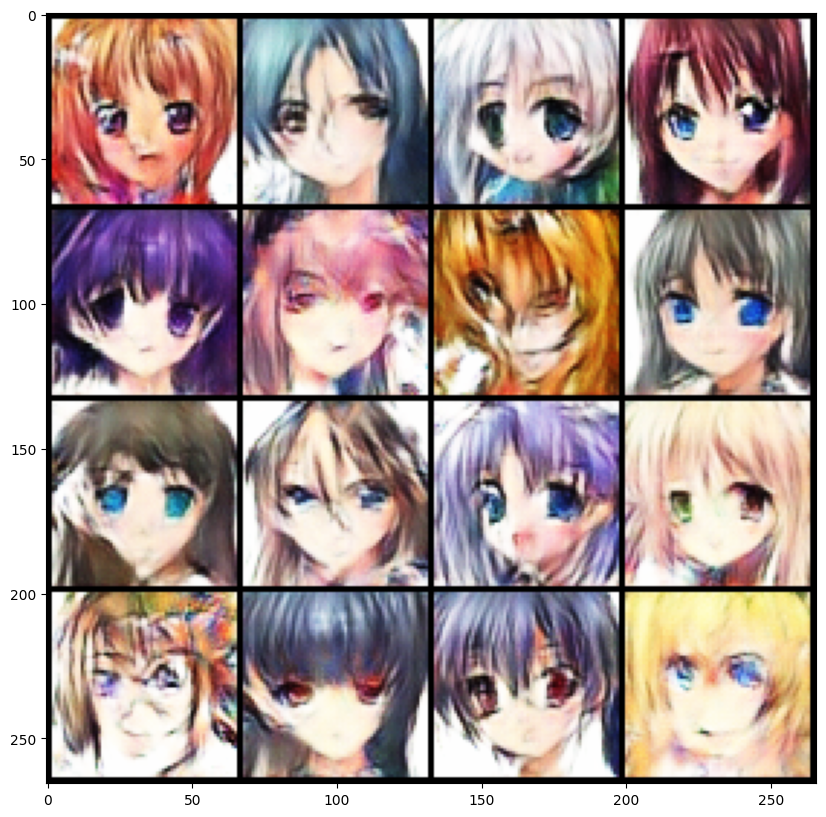

  0%|▏                                                                                 | 3/993 [00:00<01:29, 11.12it/s]

Epoch: 9 	 Disc_Loss: 0.19217830896377563 	 gen_Loss: 3.9637060165405273


 10%|████████▎                                                                       | 103/993 [00:08<01:16, 11.69it/s]

Epoch: 9 	 Disc_Loss: 0.31679272651672363 	 gen_Loss: 3.8092429637908936


 20%|████████████████▎                                                               | 203/993 [00:17<01:08, 11.62it/s]

Epoch: 9 	 Disc_Loss: 0.2084011733531952 	 gen_Loss: 2.2609026432037354


 31%|████████████████████████▍                                                       | 303/993 [00:25<00:59, 11.68it/s]

Epoch: 9 	 Disc_Loss: 0.2798530161380768 	 gen_Loss: 3.667815685272217


 41%|████████████████████████████████▍                                               | 403/993 [00:33<00:53, 11.08it/s]

Epoch: 9 	 Disc_Loss: 0.29974114894866943 	 gen_Loss: 0.9417027235031128


 51%|████████████████████████████████████████▌                                       | 503/993 [00:42<00:43, 11.20it/s]

Epoch: 9 	 Disc_Loss: 0.1789826601743698 	 gen_Loss: 2.354123592376709


 61%|████████████████████████████████████████████████▌                               | 603/993 [00:51<00:34, 11.39it/s]

Epoch: 9 	 Disc_Loss: 0.19965913891792297 	 gen_Loss: 4.144102573394775


 71%|████████████████████████████████████████████████████████▋                       | 703/993 [00:59<00:25, 11.39it/s]

Epoch: 9 	 Disc_Loss: 0.10291069746017456 	 gen_Loss: 3.631618022918701


 81%|████████████████████████████████████████████████████████████████▌               | 801/993 [01:08<00:17, 11.21it/s]

Epoch: 9 	 Disc_Loss: 0.16738654673099518 	 gen_Loss: 1.6504358053207397


 91%|████████████████████████████████████████████████████████████████████████▋       | 903/993 [01:17<00:07, 11.39it/s]

Epoch: 9 	 Disc_Loss: 0.5815587639808655 	 gen_Loss: 6.035713195800781


100%|████████████████████████████████████████████████████████████████████████████████| 993/993 [01:24<00:00, 11.70it/s]


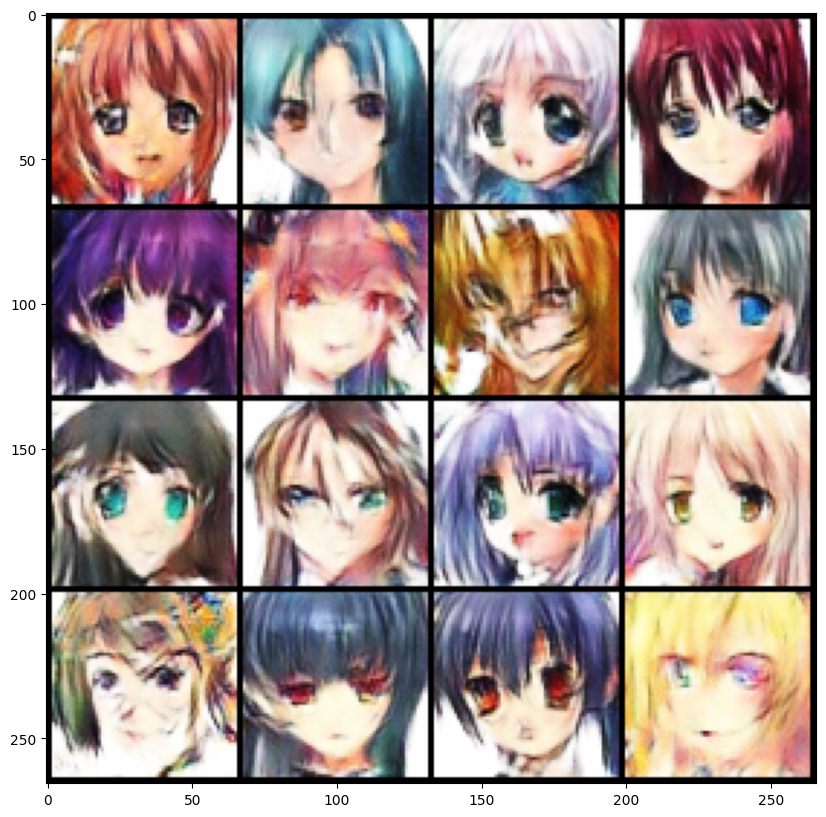

  0%|                                                                                  | 1/993 [00:00<02:00,  8.26it/s]

Epoch: 10 	 Disc_Loss: 0.2557051181793213 	 gen_Loss: 1.6544947624206543


 10%|████████▎                                                                       | 103/993 [00:08<01:16, 11.59it/s]

Epoch: 10 	 Disc_Loss: 0.8596134185791016 	 gen_Loss: 0.4246616065502167


 20%|████████████████▎                                                               | 203/993 [00:17<01:08, 11.60it/s]

Epoch: 10 	 Disc_Loss: 0.18972504138946533 	 gen_Loss: 1.7425366640090942


 31%|████████████████████████▍                                                       | 303/993 [00:25<00:59, 11.55it/s]

Epoch: 10 	 Disc_Loss: 0.09701681137084961 	 gen_Loss: 3.386068344116211


 41%|████████████████████████████████▍                                               | 403/993 [00:34<00:50, 11.58it/s]

Epoch: 10 	 Disc_Loss: 0.11671719700098038 	 gen_Loss: 2.3057429790496826


 51%|████████████████████████████████████████▌                                       | 503/993 [00:42<00:42, 11.53it/s]

Epoch: 10 	 Disc_Loss: 0.1678357571363449 	 gen_Loss: 4.219326019287109


 61%|████████████████████████████████████████████████▌                               | 603/993 [00:51<00:33, 11.62it/s]

Epoch: 10 	 Disc_Loss: 0.1683901846408844 	 gen_Loss: 3.0723586082458496


 71%|████████████████████████████████████████████████████████▋                       | 703/993 [00:59<00:24, 11.62it/s]

Epoch: 10 	 Disc_Loss: 0.18749147653579712 	 gen_Loss: 2.218888282775879


 81%|████████████████████████████████████████████████████████████████▋               | 803/993 [01:07<00:16, 11.64it/s]

Epoch: 10 	 Disc_Loss: 0.1019131988286972 	 gen_Loss: 2.1591906547546387


 91%|████████████████████████████████████████████████████████████████████████▋       | 903/993 [01:16<00:07, 11.57it/s]

Epoch: 10 	 Disc_Loss: 0.11147812008857727 	 gen_Loss: 2.410442590713501


100%|████████████████████████████████████████████████████████████████████████████████| 993/993 [01:24<00:00, 11.81it/s]


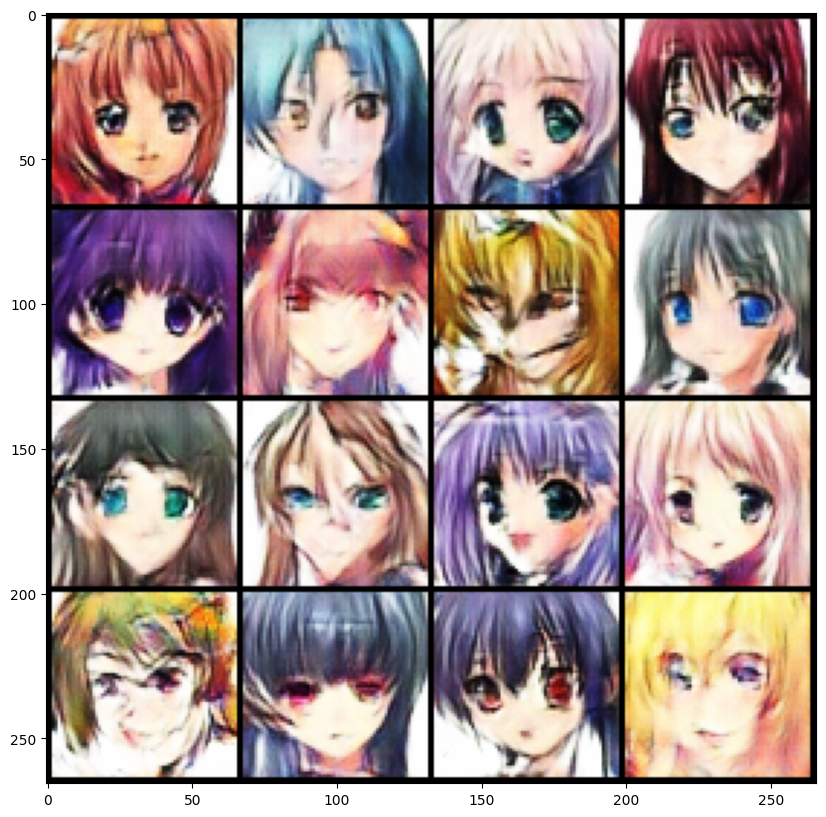

  0%|▏                                                                                 | 3/993 [00:00<01:35, 10.33it/s]

Epoch: 11 	 Disc_Loss: 0.3453238904476166 	 gen_Loss: 3.316582441329956


 10%|████████▎                                                                       | 103/993 [00:08<01:17, 11.56it/s]

Epoch: 11 	 Disc_Loss: 0.07969455420970917 	 gen_Loss: 3.7796804904937744


 20%|████████████████▎                                                               | 203/993 [00:17<01:09, 11.38it/s]

Epoch: 11 	 Disc_Loss: 0.23364675045013428 	 gen_Loss: 1.8899779319763184


 31%|████████████████████████▍                                                       | 303/993 [00:25<00:59, 11.65it/s]

Epoch: 11 	 Disc_Loss: 0.0640716552734375 	 gen_Loss: 2.9881722927093506


 41%|████████████████████████████████▍                                               | 403/993 [00:34<00:51, 11.53it/s]

Epoch: 11 	 Disc_Loss: 0.21727672219276428 	 gen_Loss: 3.387887954711914


 51%|████████████████████████████████████████▌                                       | 503/993 [00:42<00:42, 11.54it/s]

Epoch: 11 	 Disc_Loss: 0.09081931412220001 	 gen_Loss: 3.3390541076660156


 61%|████████████████████████████████████████████████▍                               | 601/993 [00:50<00:34, 11.42it/s]

Epoch: 11 	 Disc_Loss: 0.1169324442744255 	 gen_Loss: 3.1321003437042236


 71%|████████████████████████████████████████████████████████▋                       | 703/993 [00:59<00:25, 11.54it/s]

Epoch: 11 	 Disc_Loss: 0.14488759636878967 	 gen_Loss: 2.569979429244995


 81%|████████████████████████████████████████████████████████████████▋               | 803/993 [01:08<00:16, 11.51it/s]

Epoch: 11 	 Disc_Loss: 0.07547147572040558 	 gen_Loss: 3.545948028564453


 91%|████████████████████████████████████████████████████████████████████████▋       | 903/993 [01:16<00:07, 11.53it/s]

Epoch: 11 	 Disc_Loss: 0.2223941832780838 	 gen_Loss: 2.712343454360962


100%|████████████████████████████████████████████████████████████████████████████████| 993/993 [01:24<00:00, 11.79it/s]


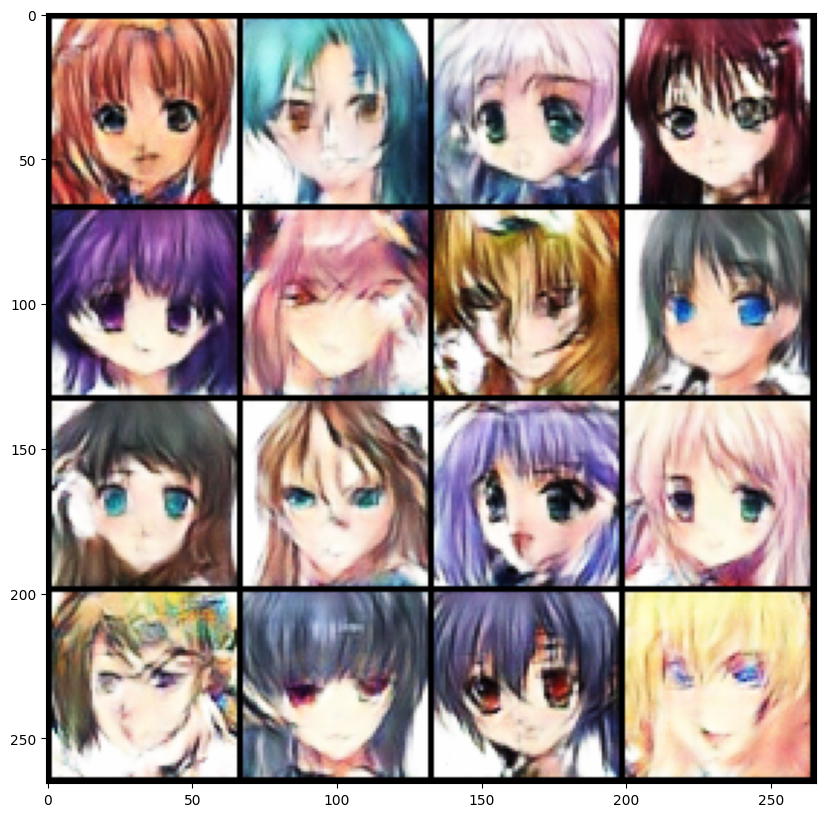

  0%|▏                                                                                 | 3/993 [00:00<01:35, 10.40it/s]

Epoch: 12 	 Disc_Loss: 0.4664905071258545 	 gen_Loss: 7.016544342041016


 10%|████████▎                                                                       | 103/993 [00:08<01:17, 11.53it/s]

Epoch: 12 	 Disc_Loss: 0.11199995875358582 	 gen_Loss: 3.179877758026123


 20%|████████████████▎                                                               | 203/993 [00:17<01:11, 11.07it/s]

Epoch: 12 	 Disc_Loss: 0.15674430131912231 	 gen_Loss: 3.6902849674224854


 31%|████████████████████████▍                                                       | 303/993 [00:26<01:02, 11.12it/s]

Epoch: 12 	 Disc_Loss: 0.089724600315094 	 gen_Loss: 3.154536247253418


 41%|████████████████████████████████▍                                               | 403/993 [00:34<00:51, 11.36it/s]

Epoch: 12 	 Disc_Loss: 0.09224005043506622 	 gen_Loss: 4.0153961181640625


 51%|████████████████████████████████████████▌                                       | 503/993 [00:43<00:43, 11.24it/s]

Epoch: 12 	 Disc_Loss: 0.05391495302319527 	 gen_Loss: 3.8385257720947266


 61%|████████████████████████████████████████████████▌                               | 603/993 [00:51<00:33, 11.54it/s]

Epoch: 12 	 Disc_Loss: 0.09336648881435394 	 gen_Loss: 4.326892375946045


 71%|████████████████████████████████████████████████████████▋                       | 703/993 [01:00<00:25, 11.56it/s]

Epoch: 12 	 Disc_Loss: 0.12490887194871902 	 gen_Loss: 3.70131254196167


 81%|████████████████████████████████████████████████████████████████▋               | 803/993 [01:08<00:16, 11.60it/s]

Epoch: 12 	 Disc_Loss: 0.10593774169683456 	 gen_Loss: 4.477005958557129


 91%|████████████████████████████████████████████████████████████████████████▋       | 903/993 [01:17<00:07, 11.53it/s]

Epoch: 12 	 Disc_Loss: 0.07036256045103073 	 gen_Loss: 3.57240629196167


100%|████████████████████████████████████████████████████████████████████████████████| 993/993 [01:25<00:00, 11.66it/s]


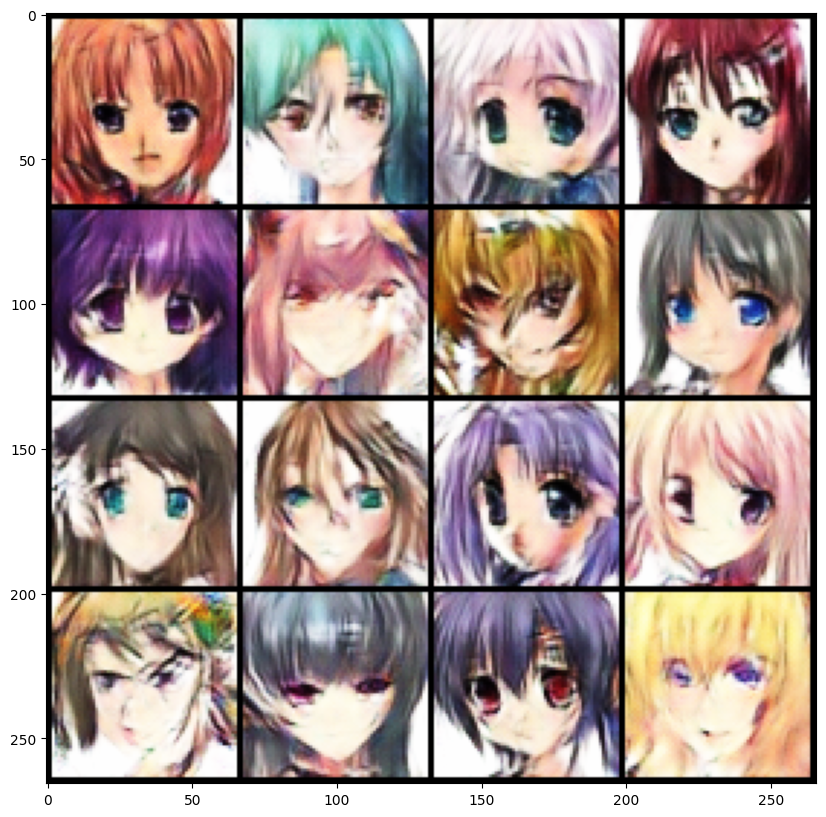

  0%|                                                                                  | 1/993 [00:00<01:57,  8.44it/s]

Epoch: 13 	 Disc_Loss: 0.09964293986558914 	 gen_Loss: 3.765686511993408


 10%|████████▎                                                                       | 103/993 [00:08<01:16, 11.58it/s]

Epoch: 13 	 Disc_Loss: 0.0748937726020813 	 gen_Loss: 4.0937395095825195


 20%|████████████████▎                                                               | 203/993 [00:17<01:07, 11.64it/s]

Epoch: 13 	 Disc_Loss: 0.1498691290616989 	 gen_Loss: 3.5553793907165527


 31%|████████████████████████▍                                                       | 303/993 [00:25<01:01, 11.13it/s]

Epoch: 13 	 Disc_Loss: 0.11036807298660278 	 gen_Loss: 3.798567771911621


 41%|████████████████████████████████▍                                               | 403/993 [00:34<00:51, 11.55it/s]

Epoch: 13 	 Disc_Loss: 0.07615287601947784 	 gen_Loss: 3.8545053005218506


 51%|████████████████████████████████████████▌                                       | 503/993 [00:42<00:42, 11.53it/s]

Epoch: 13 	 Disc_Loss: 0.089786097407341 	 gen_Loss: 3.123243808746338


 61%|████████████████████████████████████████████████▌                               | 603/993 [00:51<00:33, 11.49it/s]

Epoch: 13 	 Disc_Loss: 0.0579061359167099 	 gen_Loss: 4.168333530426025


 71%|████████████████████████████████████████████████████████▋                       | 703/993 [00:59<00:25, 11.35it/s]

Epoch: 13 	 Disc_Loss: 0.18405181169509888 	 gen_Loss: 4.599259376525879


 81%|████████████████████████████████████████████████████████████████▋               | 803/993 [01:08<00:16, 11.54it/s]

Epoch: 13 	 Disc_Loss: 0.2737709581851959 	 gen_Loss: 2.2383577823638916


 91%|████████████████████████████████████████████████████████████████████████▋       | 903/993 [01:17<00:07, 11.39it/s]

Epoch: 13 	 Disc_Loss: 0.08945062756538391 	 gen_Loss: 3.0480685234069824


100%|████████████████████████████████████████████████████████████████████████████████| 993/993 [01:24<00:00, 11.71it/s]


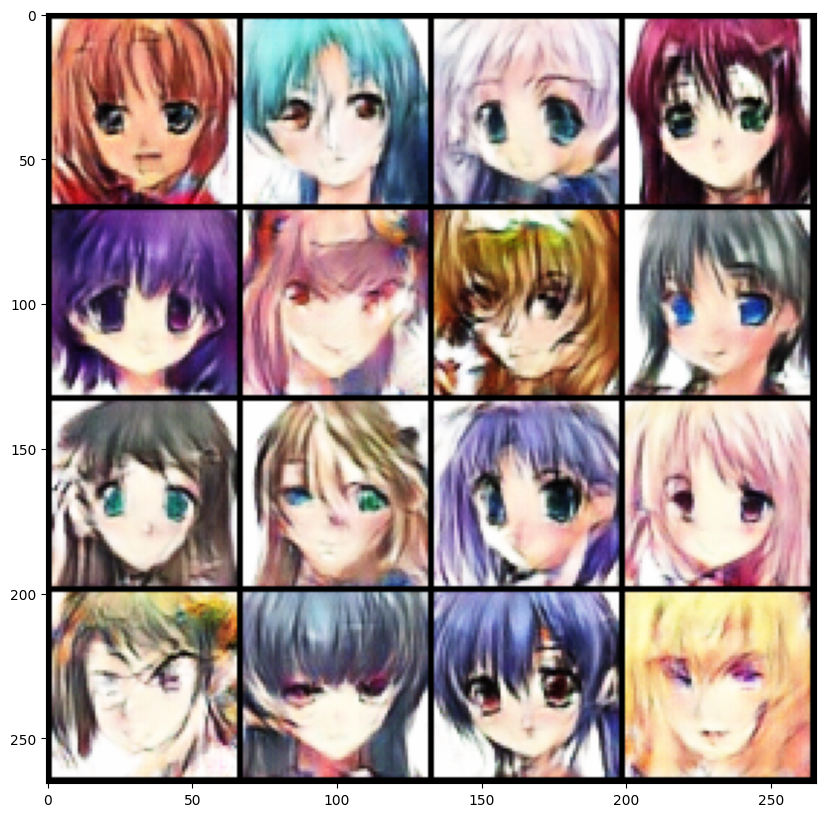

  0%|▏                                                                                 | 3/993 [00:00<01:31, 10.78it/s]

Epoch: 14 	 Disc_Loss: 0.23523975908756256 	 gen_Loss: 3.719890594482422


 10%|████████▎                                                                       | 103/993 [00:08<01:19, 11.19it/s]

Epoch: 14 	 Disc_Loss: 0.03061119094491005 	 gen_Loss: 4.31497859954834


 20%|████████████████▎                                                               | 203/993 [00:17<01:08, 11.56it/s]

Epoch: 14 	 Disc_Loss: 0.10814778506755829 	 gen_Loss: 3.9042749404907227


 31%|████████████████████████▍                                                       | 303/993 [00:25<00:59, 11.59it/s]

Epoch: 14 	 Disc_Loss: 0.044274505227804184 	 gen_Loss: 4.306760787963867


 41%|████████████████████████████████▍                                               | 403/993 [00:34<00:53, 11.09it/s]

Epoch: 14 	 Disc_Loss: 0.16256657242774963 	 gen_Loss: 3.976775884628296


 51%|████████████████████████████████████████▌                                       | 503/993 [00:42<00:42, 11.60it/s]

Epoch: 14 	 Disc_Loss: 0.23280997574329376 	 gen_Loss: 2.981801986694336


 61%|████████████████████████████████████████████████▌                               | 603/993 [00:51<00:33, 11.62it/s]

Epoch: 14 	 Disc_Loss: 0.09200982749462128 	 gen_Loss: 3.6939916610717773


 71%|████████████████████████████████████████████████████████▋                       | 703/993 [00:59<00:25, 11.54it/s]

Epoch: 14 	 Disc_Loss: 1.5838847160339355 	 gen_Loss: 10.68626880645752


 81%|████████████████████████████████████████████████████████████████▋               | 803/993 [01:08<00:16, 11.56it/s]

Epoch: 14 	 Disc_Loss: 0.046645209193229675 	 gen_Loss: 3.657252311706543


 91%|████████████████████████████████████████████████████████████████████████▋       | 903/993 [01:16<00:07, 11.62it/s]

Epoch: 14 	 Disc_Loss: 0.11925388127565384 	 gen_Loss: 2.3434700965881348


100%|████████████████████████████████████████████████████████████████████████████████| 993/993 [01:24<00:00, 11.78it/s]


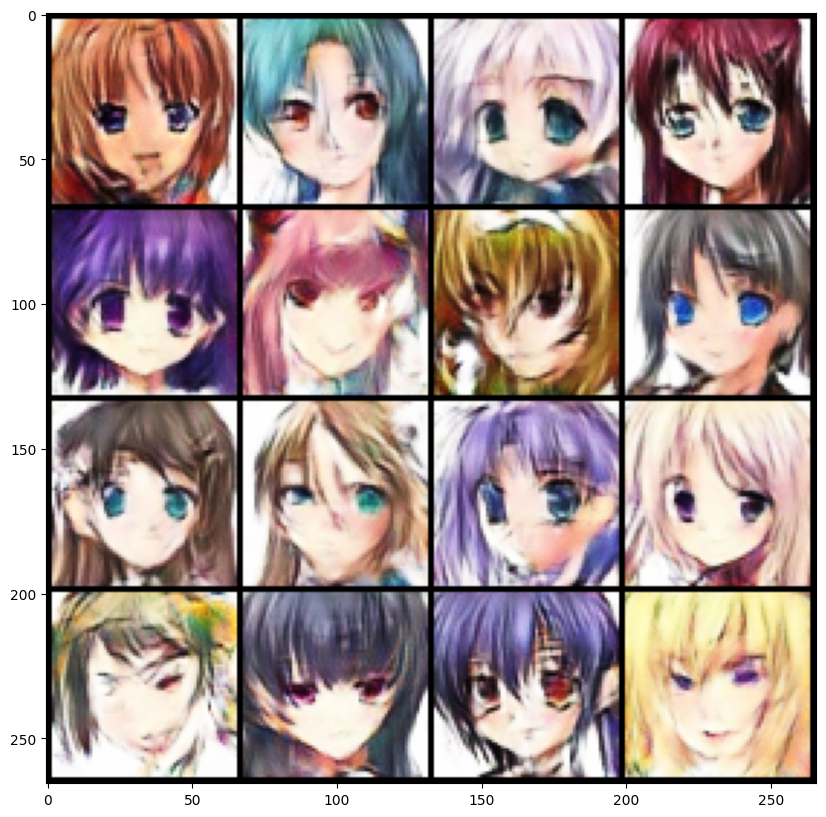

  0%|▏                                                                                 | 3/993 [00:00<01:35, 10.32it/s]

Epoch: 15 	 Disc_Loss: 0.03356198966503143 	 gen_Loss: 5.07729434967041


 10%|████████▎                                                                       | 103/993 [00:08<01:16, 11.59it/s]

Epoch: 15 	 Disc_Loss: 0.06653972715139389 	 gen_Loss: 3.375838279724121


 20%|████████████████▎                                                               | 203/993 [00:17<01:08, 11.57it/s]

Epoch: 15 	 Disc_Loss: 0.13210603594779968 	 gen_Loss: 1.3925092220306396


 31%|████████████████████████▍                                                       | 303/993 [00:25<00:59, 11.57it/s]

Epoch: 15 	 Disc_Loss: 0.05673488974571228 	 gen_Loss: 4.202704429626465


 41%|████████████████████████████████▍                                               | 403/993 [00:34<00:50, 11.57it/s]

Epoch: 15 	 Disc_Loss: 0.14200586080551147 	 gen_Loss: 3.203033924102783


 51%|████████████████████████████████████████▌                                       | 503/993 [00:42<00:42, 11.57it/s]

Epoch: 15 	 Disc_Loss: 0.24952228367328644 	 gen_Loss: 3.893400192260742


 61%|████████████████████████████████████████████████▌                               | 603/993 [00:51<00:33, 11.60it/s]

Epoch: 15 	 Disc_Loss: 0.08175447583198547 	 gen_Loss: 3.9789347648620605


 71%|████████████████████████████████████████████████████████▋                       | 703/993 [00:59<00:24, 11.63it/s]

Epoch: 15 	 Disc_Loss: 0.0647578239440918 	 gen_Loss: 4.870370864868164


 81%|████████████████████████████████████████████████████████████████▋               | 803/993 [01:07<00:16, 11.63it/s]

Epoch: 15 	 Disc_Loss: 0.23774869740009308 	 gen_Loss: 2.951504707336426


 91%|████████████████████████████████████████████████████████████████████████▌       | 901/993 [01:16<00:08, 11.31it/s]

Epoch: 15 	 Disc_Loss: 0.07513540983200073 	 gen_Loss: 3.0073084831237793


100%|████████████████████████████████████████████████████████████████████████████████| 993/993 [01:24<00:00, 11.80it/s]


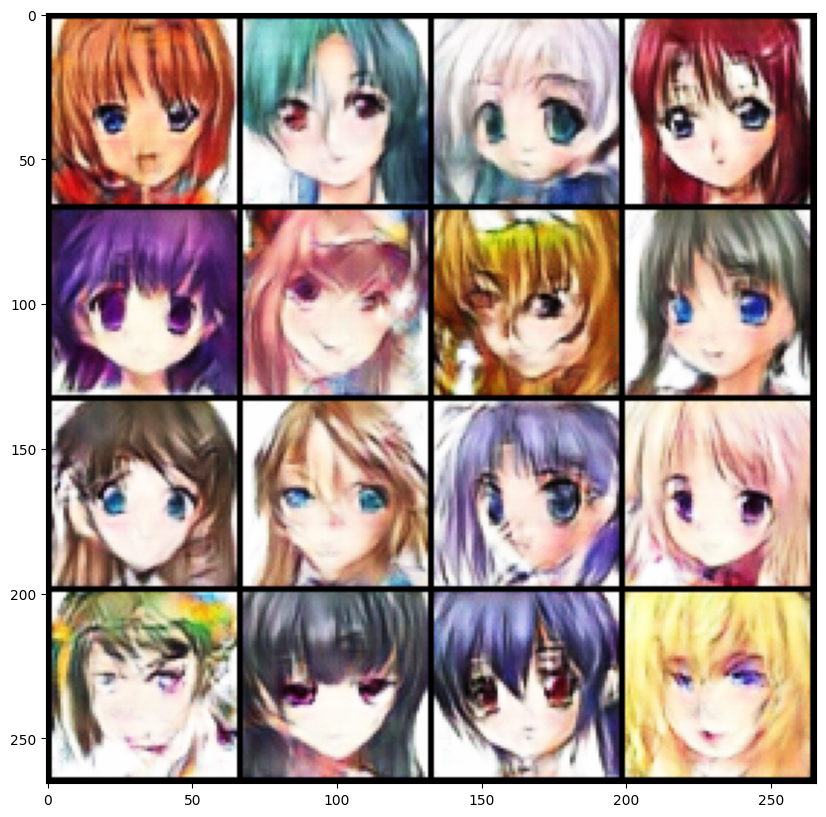

  0%|▏                                                                                 | 3/993 [00:00<01:35, 10.32it/s]

Epoch: 16 	 Disc_Loss: 0.3265286087989807 	 gen_Loss: 3.4206690788269043


 10%|████████▎                                                                       | 103/993 [00:08<01:17, 11.55it/s]

Epoch: 16 	 Disc_Loss: 0.050620365887880325 	 gen_Loss: 3.782529354095459


 20%|████████████████▎                                                               | 203/993 [00:17<01:07, 11.65it/s]

Epoch: 16 	 Disc_Loss: 0.05079212039709091 	 gen_Loss: 3.863326072692871


 31%|████████████████████████▍                                                       | 303/993 [00:25<00:59, 11.61it/s]

Epoch: 16 	 Disc_Loss: 0.15819762647151947 	 gen_Loss: 2.7176284790039062


 41%|████████████████████████████████▍                                               | 403/993 [00:34<00:51, 11.45it/s]

Epoch: 16 	 Disc_Loss: 0.13099229335784912 	 gen_Loss: 3.783690929412842


 51%|████████████████████████████████████████▌                                       | 503/993 [00:42<00:42, 11.54it/s]

Epoch: 16 	 Disc_Loss: 0.1839248687028885 	 gen_Loss: 5.784440994262695


 61%|████████████████████████████████████████████████▌                               | 603/993 [00:51<00:33, 11.59it/s]

Epoch: 16 	 Disc_Loss: 0.06998303532600403 	 gen_Loss: 5.478985786437988


 71%|████████████████████████████████████████████████████████▋                       | 703/993 [00:59<00:25, 11.59it/s]

Epoch: 16 	 Disc_Loss: 0.11528074741363525 	 gen_Loss: 2.9748592376708984


 81%|████████████████████████████████████████████████████████████████▋               | 803/993 [01:08<00:16, 11.50it/s]

Epoch: 16 	 Disc_Loss: 0.06370532512664795 	 gen_Loss: 1.917771577835083


 91%|████████████████████████████████████████████████████████████████████████▋       | 903/993 [01:16<00:07, 11.40it/s]

Epoch: 16 	 Disc_Loss: 0.021794158965349197 	 gen_Loss: 4.627860069274902


100%|████████████████████████████████████████████████████████████████████████████████| 993/993 [01:24<00:00, 11.79it/s]


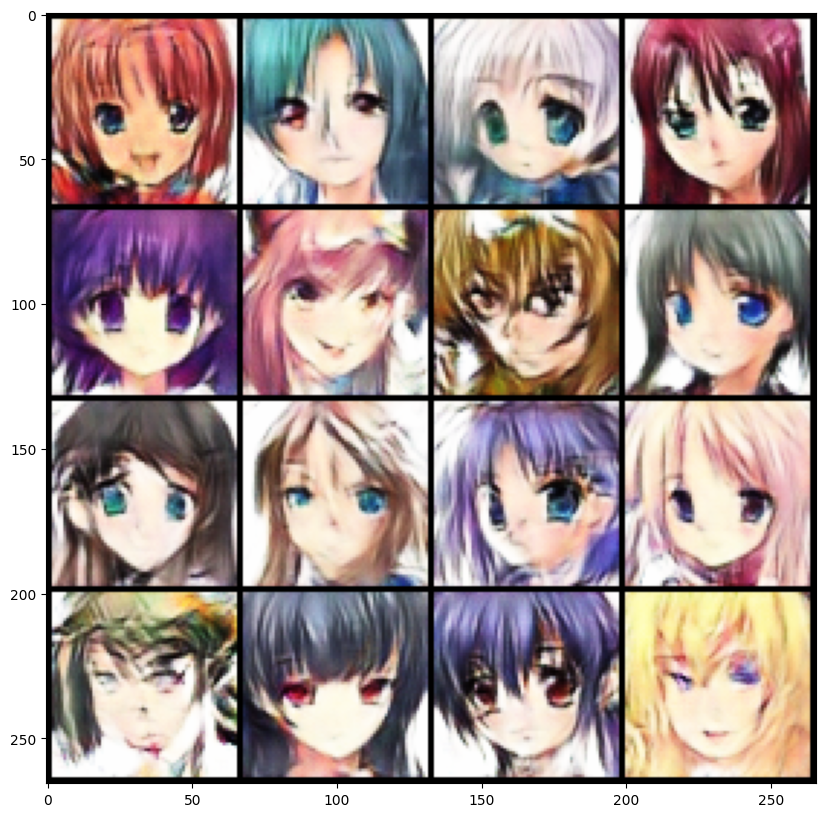

  0%|▏                                                                                 | 3/993 [00:00<01:35, 10.36it/s]

Epoch: 17 	 Disc_Loss: 1.4981067180633545 	 gen_Loss: 9.648900985717773


 10%|████████▎                                                                       | 103/993 [00:08<01:16, 11.58it/s]

Epoch: 17 	 Disc_Loss: 0.056421976536512375 	 gen_Loss: 3.99190092086792


 20%|████████████████▎                                                               | 203/993 [00:17<01:08, 11.56it/s]

Epoch: 17 	 Disc_Loss: 0.06471261382102966 	 gen_Loss: 4.205620765686035


 31%|████████████████████████▍                                                       | 303/993 [00:25<00:59, 11.64it/s]

Epoch: 17 	 Disc_Loss: 0.24667620658874512 	 gen_Loss: 7.090912818908691


 41%|████████████████████████████████▍                                               | 403/993 [00:34<00:51, 11.46it/s]

Epoch: 17 	 Disc_Loss: 0.027507610619068146 	 gen_Loss: 4.612837791442871


 51%|████████████████████████████████████████▌                                       | 503/993 [00:42<00:42, 11.50it/s]

Epoch: 17 	 Disc_Loss: 0.09816012531518936 	 gen_Loss: 4.017947196960449


 61%|████████████████████████████████████████████████▌                               | 603/993 [00:51<00:33, 11.60it/s]

Epoch: 17 	 Disc_Loss: 2.8940608501434326 	 gen_Loss: 2.685950756072998


 71%|████████████████████████████████████████████████████████▋                       | 703/993 [01:00<00:24, 11.62it/s]

Epoch: 17 	 Disc_Loss: 0.12028766423463821 	 gen_Loss: 5.826513290405273


 81%|████████████████████████████████████████████████████████████████▋               | 803/993 [01:08<00:16, 11.53it/s]

Epoch: 17 	 Disc_Loss: 0.03022651933133602 	 gen_Loss: 3.9087672233581543


 91%|████████████████████████████████████████████████████████████████████████▋       | 903/993 [01:17<00:07, 11.64it/s]

Epoch: 17 	 Disc_Loss: 0.0585932731628418 	 gen_Loss: 4.615477561950684


100%|████████████████████████████████████████████████████████████████████████████████| 993/993 [01:24<00:00, 11.74it/s]


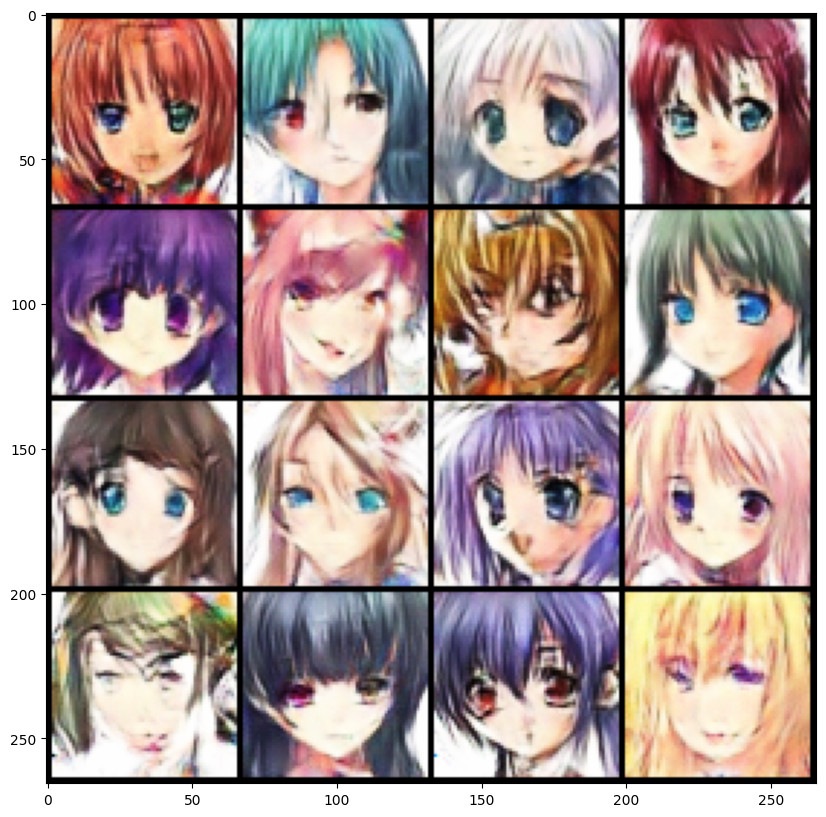

  0%|▏                                                                                 | 3/993 [00:00<01:35, 10.35it/s]

Epoch: 18 	 Disc_Loss: 0.026812242344021797 	 gen_Loss: 5.042696952819824


 10%|████████▎                                                                       | 103/993 [00:08<01:17, 11.56it/s]

Epoch: 18 	 Disc_Loss: 0.10497739911079407 	 gen_Loss: 4.193368911743164


 20%|████████████████▎                                                               | 203/993 [00:17<01:08, 11.56it/s]

Epoch: 18 	 Disc_Loss: 0.06388162076473236 	 gen_Loss: 5.01315975189209


 31%|████████████████████████▍                                                       | 303/993 [00:25<00:59, 11.55it/s]

Epoch: 18 	 Disc_Loss: 0.03352691978216171 	 gen_Loss: 4.404127597808838


 41%|████████████████████████████████▍                                               | 403/993 [00:34<00:50, 11.58it/s]

Epoch: 18 	 Disc_Loss: 0.3715750277042389 	 gen_Loss: 4.854621410369873


 51%|████████████████████████████████████████▌                                       | 503/993 [00:42<00:42, 11.56it/s]

Epoch: 18 	 Disc_Loss: 0.07044334709644318 	 gen_Loss: 3.5478084087371826


 61%|████████████████████████████████████████████████▌                               | 603/993 [00:51<00:33, 11.60it/s]

Epoch: 18 	 Disc_Loss: 0.021660111844539642 	 gen_Loss: 4.604110240936279


 71%|████████████████████████████████████████████████████████▌                       | 702/993 [00:59<00:25, 11.29it/s]

Epoch: 18 	 Disc_Loss: 0.050890401005744934 	 gen_Loss: 4.162614822387695


 81%|████████████████████████████████████████████████████████████████▌               | 802/993 [01:08<00:16, 11.41it/s]

Epoch: 18 	 Disc_Loss: 0.05231792852282524 	 gen_Loss: 4.803050518035889


 91%|████████████████████████████████████████████████████████████████████████▋       | 902/993 [01:16<00:07, 11.39it/s]

Epoch: 18 	 Disc_Loss: 0.051121700555086136 	 gen_Loss: 3.640096664428711


100%|████████████████████████████████████████████████████████████████████████████████| 993/993 [01:24<00:00, 11.74it/s]


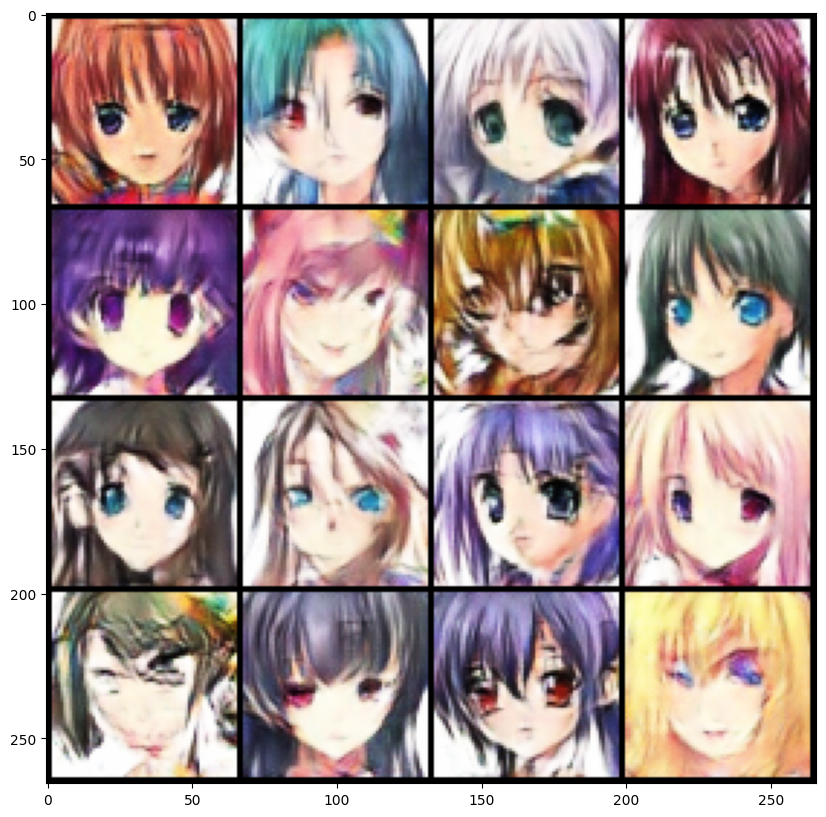

  0%|▏                                                                                 | 3/993 [00:00<01:36, 10.26it/s]

Epoch: 19 	 Disc_Loss: 0.04122893884778023 	 gen_Loss: 5.301669597625732


 10%|████████▎                                                                       | 103/993 [00:08<01:16, 11.62it/s]

Epoch: 19 	 Disc_Loss: 0.1924147605895996 	 gen_Loss: 3.6395511627197266


 20%|████████████████▏                                                               | 201/993 [00:17<01:11, 11.09it/s]

Epoch: 19 	 Disc_Loss: 0.3235211670398712 	 gen_Loss: 8.12532901763916


 31%|████████████████████████▍                                                       | 303/993 [00:26<01:00, 11.46it/s]

Epoch: 19 	 Disc_Loss: 0.07875362783670425 	 gen_Loss: 5.217755317687988


 41%|████████████████████████████████▍                                               | 403/993 [00:34<00:51, 11.54it/s]

Epoch: 19 	 Disc_Loss: 0.25184446573257446 	 gen_Loss: 2.1512160301208496


 51%|████████████████████████████████████████▌                                       | 503/993 [00:43<00:42, 11.48it/s]

Epoch: 19 	 Disc_Loss: 0.5348954200744629 	 gen_Loss: 0.14219827950000763


 61%|████████████████████████████████████████████████▌                               | 603/993 [00:51<00:34, 11.45it/s]

Epoch: 19 	 Disc_Loss: 0.032920971512794495 	 gen_Loss: 4.1754655838012695


 71%|████████████████████████████████████████████████████████▋                       | 703/993 [01:00<00:25, 11.56it/s]

Epoch: 19 	 Disc_Loss: 0.03333795443177223 	 gen_Loss: 5.062376976013184


 81%|████████████████████████████████████████████████████████████████▋               | 803/993 [01:08<00:16, 11.52it/s]

Epoch: 19 	 Disc_Loss: 0.04607580974698067 	 gen_Loss: 3.559842586517334


 91%|████████████████████████████████████████████████████████████████████████▋       | 903/993 [01:17<00:07, 11.53it/s]

Epoch: 19 	 Disc_Loss: 0.4770544171333313 	 gen_Loss: 2.1659250259399414


100%|████████████████████████████████████████████████████████████████████████████████| 993/993 [01:24<00:00, 11.69it/s]


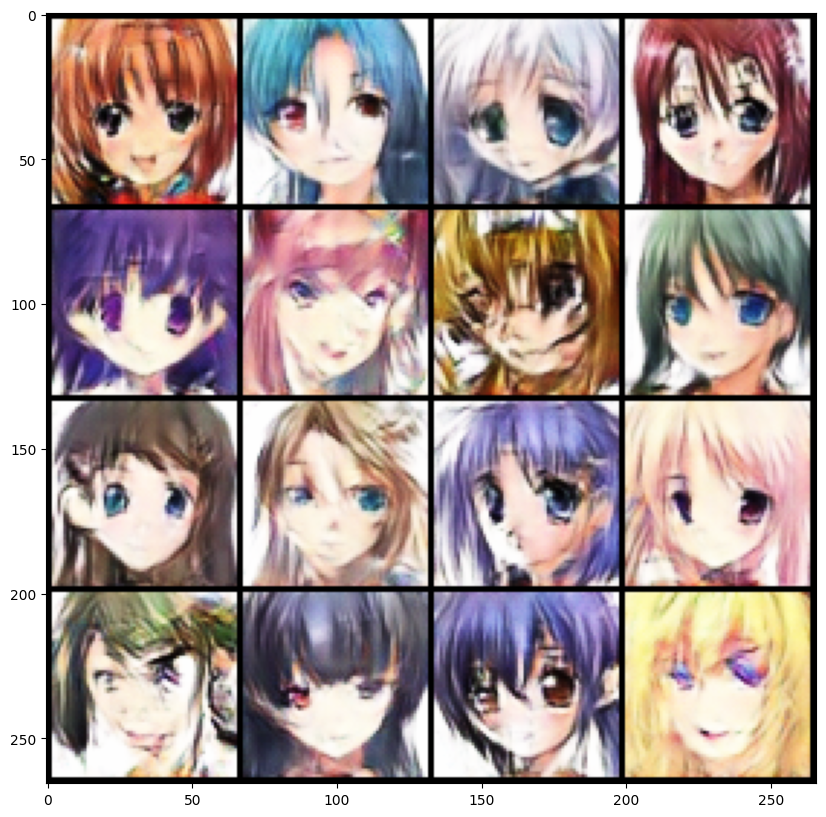

  0%|▏                                                                                 | 3/993 [00:00<01:34, 10.46it/s]

Epoch: 20 	 Disc_Loss: 0.038896121084690094 	 gen_Loss: 4.445568084716797


 10%|████████▎                                                                       | 103/993 [00:08<01:16, 11.58it/s]

Epoch: 20 	 Disc_Loss: 0.03916657343506813 	 gen_Loss: 5.504868507385254


 20%|████████████████▎                                                               | 203/993 [00:17<01:08, 11.58it/s]

Epoch: 20 	 Disc_Loss: 0.10131464153528214 	 gen_Loss: 3.928737163543701


 31%|████████████████████████▍                                                       | 303/993 [00:25<00:59, 11.55it/s]

Epoch: 20 	 Disc_Loss: 0.023858819156885147 	 gen_Loss: 6.5948486328125


 41%|████████████████████████████████▍                                               | 403/993 [00:34<00:51, 11.55it/s]

Epoch: 20 	 Disc_Loss: 0.1764402836561203 	 gen_Loss: 3.7309274673461914


 51%|████████████████████████████████████████▌                                       | 503/993 [00:43<00:43, 11.16it/s]

Epoch: 20 	 Disc_Loss: 0.04274483025074005 	 gen_Loss: 4.612948417663574


 61%|████████████████████████████████████████████████▌                               | 603/993 [00:51<00:33, 11.56it/s]

Epoch: 20 	 Disc_Loss: 0.038519445806741714 	 gen_Loss: 4.109609127044678


 71%|████████████████████████████████████████████████████████▋                       | 703/993 [01:00<00:25, 11.37it/s]

Epoch: 20 	 Disc_Loss: 0.024729901924729347 	 gen_Loss: 4.566783905029297


 81%|████████████████████████████████████████████████████████████████▋               | 803/993 [01:08<00:16, 11.56it/s]

Epoch: 20 	 Disc_Loss: 0.07877835631370544 	 gen_Loss: 4.3229265213012695


 91%|████████████████████████████████████████████████████████████████████████▋       | 903/993 [01:17<00:07, 11.46it/s]

Epoch: 20 	 Disc_Loss: 0.05149143561720848 	 gen_Loss: 3.58919358253479


100%|████████████████████████████████████████████████████████████████████████████████| 993/993 [01:25<00:00, 11.68it/s]


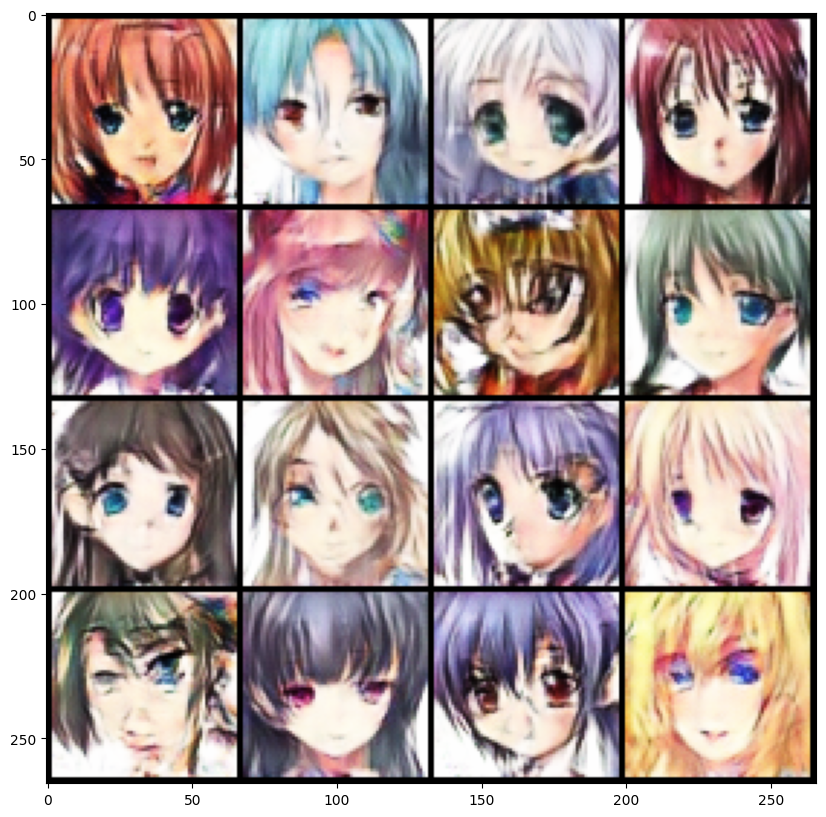

  0%|▏                                                                                 | 3/993 [00:00<01:34, 10.45it/s]

Epoch: 21 	 Disc_Loss: 0.03021685779094696 	 gen_Loss: 4.138716697692871


 10%|████████▎                                                                       | 103/993 [00:08<01:17, 11.43it/s]

Epoch: 21 	 Disc_Loss: 0.024403341114521027 	 gen_Loss: 5.307441711425781


 20%|████████████████▎                                                               | 203/993 [00:17<01:09, 11.40it/s]

Epoch: 21 	 Disc_Loss: 0.07635148614645004 	 gen_Loss: 5.165811538696289


 31%|████████████████████████▍                                                       | 303/993 [00:25<01:00, 11.45it/s]

Epoch: 21 	 Disc_Loss: 0.07639680802822113 	 gen_Loss: 2.579577922821045


 41%|████████████████████████████████▍                                               | 403/993 [00:34<00:51, 11.48it/s]

Epoch: 21 	 Disc_Loss: 0.01988298073410988 	 gen_Loss: 4.643026351928711


 51%|████████████████████████████████████████▍                                       | 502/993 [00:43<00:43, 11.27it/s]

Epoch: 21 	 Disc_Loss: 0.029434407129883766 	 gen_Loss: 4.186829566955566


 61%|████████████████████████████████████████████████▍                               | 602/993 [00:51<00:34, 11.33it/s]

Epoch: 21 	 Disc_Loss: 0.01738944835960865 	 gen_Loss: 4.058594226837158


 71%|████████████████████████████████████████████████████████▌                       | 702/993 [01:00<00:25, 11.25it/s]

Epoch: 21 	 Disc_Loss: 0.1405666172504425 	 gen_Loss: 2.99326753616333


 81%|████████████████████████████████████████████████████████████████▌               | 802/993 [01:08<00:16, 11.32it/s]

Epoch: 21 	 Disc_Loss: 0.03792334347963333 	 gen_Loss: 3.5952930450439453


 91%|████████████████████████████████████████████████████████████████████████▋       | 902/993 [01:17<00:07, 11.41it/s]

Epoch: 21 	 Disc_Loss: 0.033189624547958374 	 gen_Loss: 4.480377197265625


100%|████████████████████████████████████████████████████████████████████████████████| 993/993 [01:25<00:00, 11.65it/s]


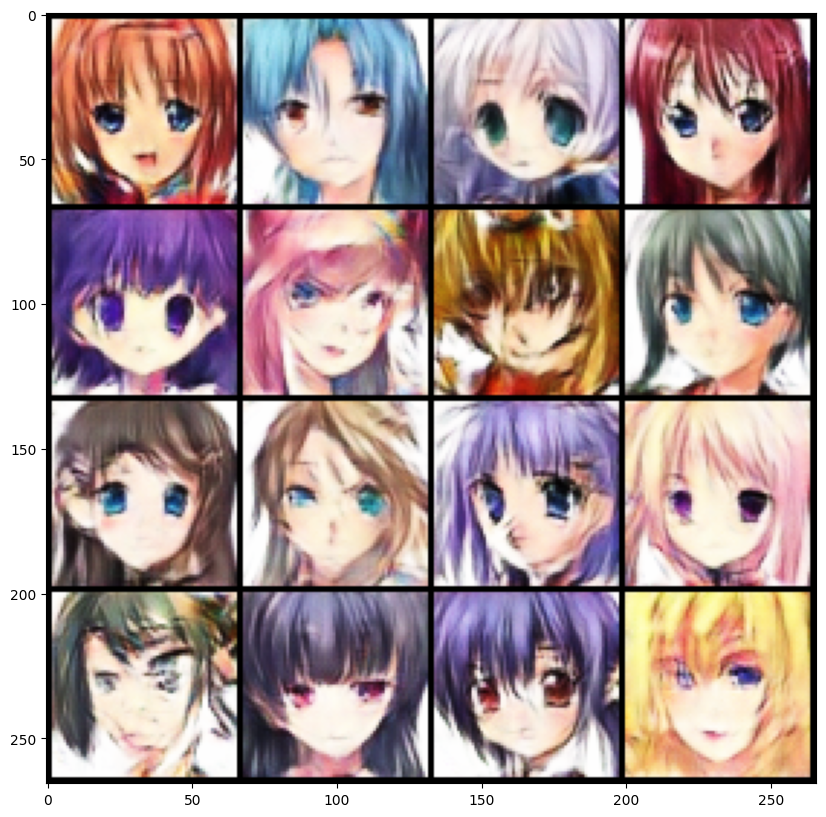

  0%|▏                                                                                 | 3/993 [00:00<01:36, 10.29it/s]

Epoch: 22 	 Disc_Loss: 0.015109863132238388 	 gen_Loss: 4.311769962310791


 10%|████████▎                                                                       | 103/993 [00:08<01:16, 11.59it/s]

Epoch: 22 	 Disc_Loss: 0.013993997126817703 	 gen_Loss: 5.284878730773926


 20%|████████████████▎                                                               | 203/993 [00:17<01:08, 11.54it/s]

Epoch: 22 	 Disc_Loss: 0.04866735637187958 	 gen_Loss: 4.975864887237549


 31%|████████████████████████▍                                                       | 303/993 [00:25<00:59, 11.57it/s]

Epoch: 22 	 Disc_Loss: 0.07169348001480103 	 gen_Loss: 4.596938133239746


 41%|████████████████████████████████▍                                               | 403/993 [00:34<00:51, 11.40it/s]

Epoch: 22 	 Disc_Loss: 0.09926220774650574 	 gen_Loss: 2.8517329692840576


 51%|████████████████████████████████████████▌                                       | 503/993 [00:42<00:42, 11.52it/s]

Epoch: 22 	 Disc_Loss: 0.05683079734444618 	 gen_Loss: 4.680789470672607


 61%|████████████████████████████████████████████████▌                               | 603/993 [00:51<00:33, 11.59it/s]

Epoch: 22 	 Disc_Loss: 0.011829977855086327 	 gen_Loss: 5.832356929779053


 71%|████████████████████████████████████████████████████████▋                       | 703/993 [00:59<00:25, 11.48it/s]

Epoch: 22 	 Disc_Loss: 0.05707070231437683 	 gen_Loss: 3.744394302368164


 81%|████████████████████████████████████████████████████████████████▋               | 803/993 [01:08<00:16, 11.54it/s]

Epoch: 22 	 Disc_Loss: 0.06949262320995331 	 gen_Loss: 5.132458209991455


 91%|████████████████████████████████████████████████████████████████████████▋       | 903/993 [01:16<00:07, 11.44it/s]

Epoch: 22 	 Disc_Loss: 0.008844194933772087 	 gen_Loss: 5.184304714202881


100%|████████████████████████████████████████████████████████████████████████████████| 993/993 [01:24<00:00, 11.76it/s]


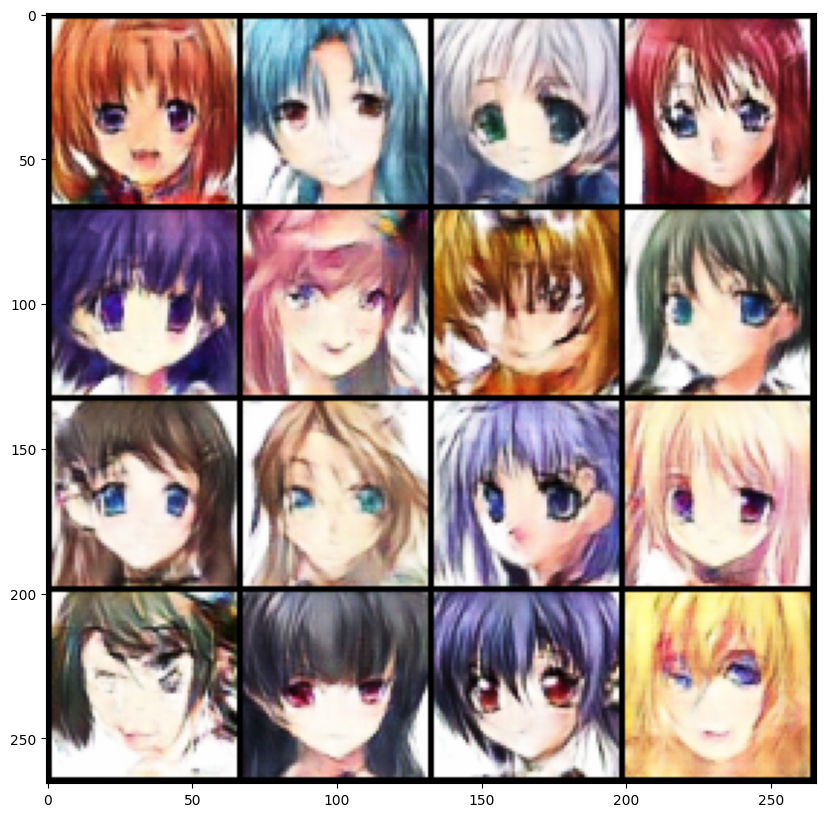

  0%|                                                                                  | 1/993 [00:00<01:55,  8.58it/s]

Epoch: 23 	 Disc_Loss: 0.09497226774692535 	 gen_Loss: 4.2766265869140625


 10%|████████▎                                                                       | 103/993 [00:08<01:16, 11.62it/s]

Epoch: 23 	 Disc_Loss: 0.018168296664953232 	 gen_Loss: 4.459869384765625


 20%|████████████████▎                                                               | 203/993 [00:17<01:07, 11.63it/s]

Epoch: 23 	 Disc_Loss: 0.023205213248729706 	 gen_Loss: 6.062913417816162


 31%|████████████████████████▍                                                       | 303/993 [00:25<01:01, 11.30it/s]

Epoch: 23 	 Disc_Loss: 0.029931502416729927 	 gen_Loss: 4.706386566162109


 41%|████████████████████████████████▍                                               | 403/993 [00:34<00:57, 10.29it/s]

Epoch: 23 	 Disc_Loss: 0.03478414565324783 	 gen_Loss: 4.389606952667236


 51%|████████████████████████████████████████▌                                       | 503/993 [00:43<00:41, 11.67it/s]

Epoch: 23 	 Disc_Loss: 0.04265318810939789 	 gen_Loss: 5.5403642654418945


 61%|████████████████████████████████████████████████▌                               | 603/993 [00:51<00:33, 11.54it/s]

Epoch: 23 	 Disc_Loss: 0.045451268553733826 	 gen_Loss: 5.73604154586792


 71%|████████████████████████████████████████████████████████▋                       | 703/993 [01:00<00:25, 11.52it/s]

Epoch: 23 	 Disc_Loss: 0.04042528569698334 	 gen_Loss: 3.6708505153656006


 81%|████████████████████████████████████████████████████████████████▋               | 803/993 [01:08<00:16, 11.56it/s]

Epoch: 23 	 Disc_Loss: 0.09073513001203537 	 gen_Loss: 2.8345794677734375


 91%|████████████████████████████████████████████████████████████████████████▋       | 903/993 [01:17<00:07, 11.44it/s]

Epoch: 23 	 Disc_Loss: 0.02473517134785652 	 gen_Loss: 4.397426128387451


100%|████████████████████████████████████████████████████████████████████████████████| 993/993 [01:24<00:00, 11.72it/s]


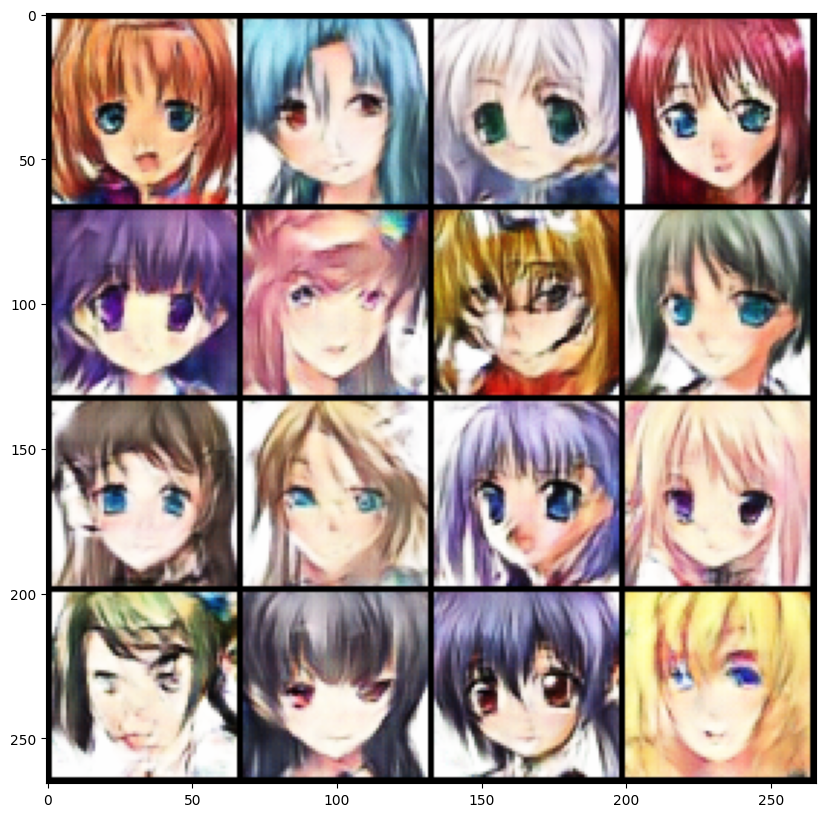

  0%|▏                                                                                 | 3/993 [00:00<01:37, 10.12it/s]

Epoch: 24 	 Disc_Loss: 0.25485754013061523 	 gen_Loss: 3.6867003440856934


 10%|████████▎                                                                       | 103/993 [00:08<01:16, 11.65it/s]

Epoch: 24 	 Disc_Loss: 0.023986319079995155 	 gen_Loss: 4.4188690185546875


 20%|████████████████▎                                                               | 203/993 [00:17<01:08, 11.52it/s]

Epoch: 24 	 Disc_Loss: 0.04668695852160454 	 gen_Loss: 3.7048349380493164


 30%|████████████████████████▏                                                       | 301/993 [00:25<01:00, 11.39it/s]

Epoch: 24 	 Disc_Loss: 0.03371701389551163 	 gen_Loss: 5.060853481292725


 41%|████████████████████████████████▍                                               | 403/993 [00:34<00:52, 11.25it/s]

Epoch: 24 	 Disc_Loss: 0.011532217264175415 	 gen_Loss: 5.003654956817627


 51%|████████████████████████████████████████▌                                       | 503/993 [00:42<00:42, 11.55it/s]

Epoch: 24 	 Disc_Loss: 0.012315887026488781 	 gen_Loss: 4.223171234130859


 61%|████████████████████████████████████████████████▌                               | 603/993 [00:51<00:33, 11.56it/s]

Epoch: 24 	 Disc_Loss: 0.47194719314575195 	 gen_Loss: 4.850756645202637


 71%|████████████████████████████████████████████████████████▋                       | 703/993 [00:59<00:25, 11.49it/s]

Epoch: 24 	 Disc_Loss: 0.10650001466274261 	 gen_Loss: 4.33819580078125


 81%|████████████████████████████████████████████████████████████████▋               | 803/993 [01:08<00:16, 11.60it/s]

Epoch: 24 	 Disc_Loss: 0.0337039940059185 	 gen_Loss: 4.701348781585693


 91%|████████████████████████████████████████████████████████████████████████▋       | 903/993 [01:16<00:07, 11.57it/s]

Epoch: 24 	 Disc_Loss: 0.11678275465965271 	 gen_Loss: 3.055882692337036


100%|████████████████████████████████████████████████████████████████████████████████| 993/993 [01:24<00:00, 11.77it/s]


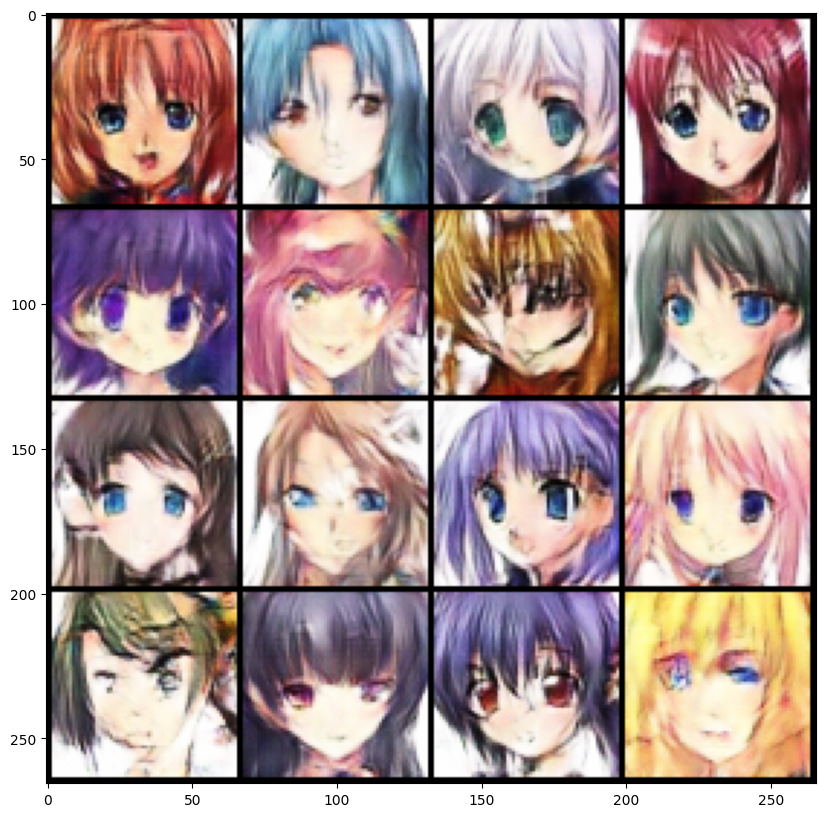

  0%|▏                                                                                 | 3/993 [00:00<01:34, 10.52it/s]

Epoch: 25 	 Disc_Loss: 0.07558374106884003 	 gen_Loss: 4.715361595153809


 10%|████████▎                                                                       | 103/993 [00:08<01:16, 11.65it/s]

Epoch: 25 	 Disc_Loss: 0.18846309185028076 	 gen_Loss: 4.821385383605957


 20%|████████████████▎                                                               | 203/993 [00:17<01:08, 11.49it/s]

Epoch: 25 	 Disc_Loss: 0.0290538277477026 	 gen_Loss: 4.124434471130371


 31%|████████████████████████▍                                                       | 303/993 [00:25<00:59, 11.63it/s]

Epoch: 25 	 Disc_Loss: 0.05137567222118378 	 gen_Loss: 4.297181606292725


 41%|████████████████████████████████▍                                               | 403/993 [00:34<00:51, 11.42it/s]

Epoch: 25 	 Disc_Loss: 0.07806926965713501 	 gen_Loss: 3.7759764194488525


 51%|████████████████████████████████████████▌                                       | 503/993 [00:42<00:43, 11.36it/s]

Epoch: 25 	 Disc_Loss: 0.031727638095617294 	 gen_Loss: 4.620875358581543


 61%|████████████████████████████████████████████████▌                               | 603/993 [00:51<00:33, 11.57it/s]

Epoch: 25 	 Disc_Loss: 0.04814701899886131 	 gen_Loss: 4.77818489074707


 71%|████████████████████████████████████████████████████████▋                       | 703/993 [01:00<00:25, 11.43it/s]

Epoch: 25 	 Disc_Loss: 0.018620895221829414 	 gen_Loss: 5.5354719161987305


 81%|████████████████████████████████████████████████████████████████▋               | 803/993 [01:08<00:16, 11.57it/s]

Epoch: 25 	 Disc_Loss: 0.03044225461781025 	 gen_Loss: 4.145486831665039


 91%|████████████████████████████████████████████████████████████████████████▋       | 903/993 [01:17<00:07, 11.46it/s]

Epoch: 25 	 Disc_Loss: 0.017882969230413437 	 gen_Loss: 5.0014753341674805


100%|████████████████████████████████████████████████████████████████████████████████| 993/993 [01:24<00:00, 11.74it/s]


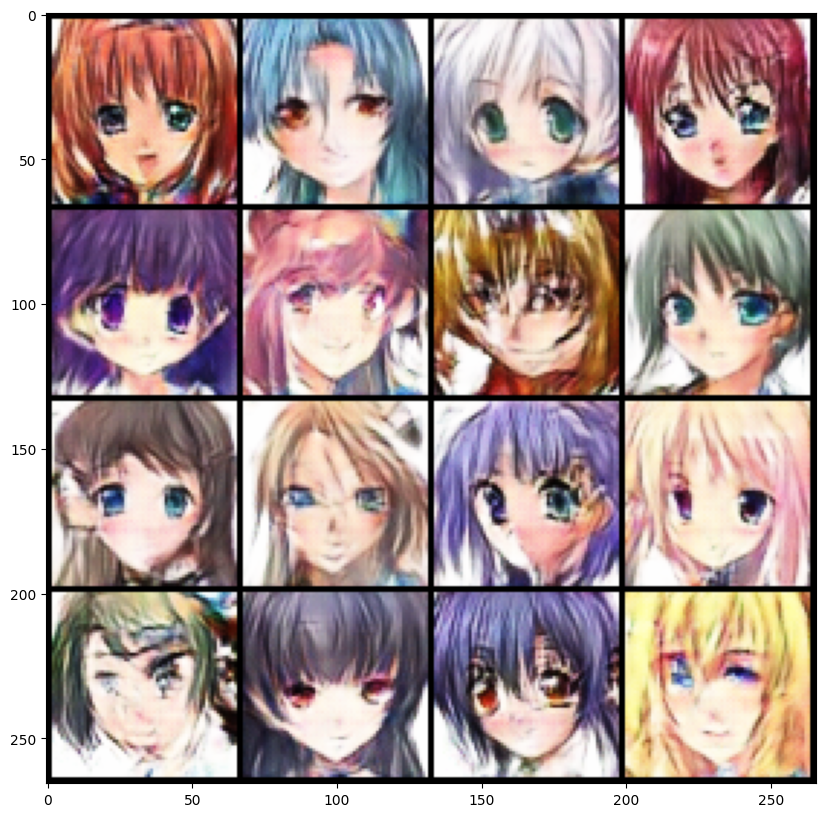

  0%|                                                                                  | 1/993 [00:00<02:02,  8.10it/s]

Epoch: 26 	 Disc_Loss: 0.6383790969848633 	 gen_Loss: 8.022102355957031


 10%|████████▎                                                                       | 103/993 [00:08<01:16, 11.59it/s]

Epoch: 26 	 Disc_Loss: 0.07907715439796448 	 gen_Loss: 4.837705135345459


 20%|████████████████▎                                                               | 203/993 [00:17<01:10, 11.28it/s]

Epoch: 26 	 Disc_Loss: 0.20484334230422974 	 gen_Loss: 3.354527473449707


 31%|████████████████████████▍                                                       | 303/993 [00:25<00:59, 11.56it/s]

Epoch: 26 	 Disc_Loss: 0.016599107533693314 	 gen_Loss: 4.256755352020264


 41%|████████████████████████████████▍                                               | 403/993 [00:34<00:51, 11.52it/s]

Epoch: 26 	 Disc_Loss: 0.027461053803563118 	 gen_Loss: 5.2211151123046875


 51%|████████████████████████████████████████▌                                       | 503/993 [00:42<00:42, 11.55it/s]

Epoch: 26 	 Disc_Loss: 0.011747576296329498 	 gen_Loss: 4.410866737365723


 61%|████████████████████████████████████████████████▌                               | 603/993 [00:51<00:33, 11.47it/s]

Epoch: 26 	 Disc_Loss: 0.02149590663611889 	 gen_Loss: 3.727872848510742


 71%|████████████████████████████████████████████████████████▋                       | 703/993 [00:59<00:25, 11.59it/s]

Epoch: 26 	 Disc_Loss: 0.05641685798764229 	 gen_Loss: 3.964052200317383


 81%|████████████████████████████████████████████████████████████████▋               | 803/993 [01:08<00:16, 11.60it/s]

Epoch: 26 	 Disc_Loss: 0.030385348945856094 	 gen_Loss: 4.89578914642334


 91%|████████████████████████████████████████████████████████████████████████▋       | 903/993 [01:16<00:07, 11.54it/s]

Epoch: 26 	 Disc_Loss: 0.028537306934595108 	 gen_Loss: 4.789312362670898


100%|████████████████████████████████████████████████████████████████████████████████| 993/993 [01:24<00:00, 11.76it/s]


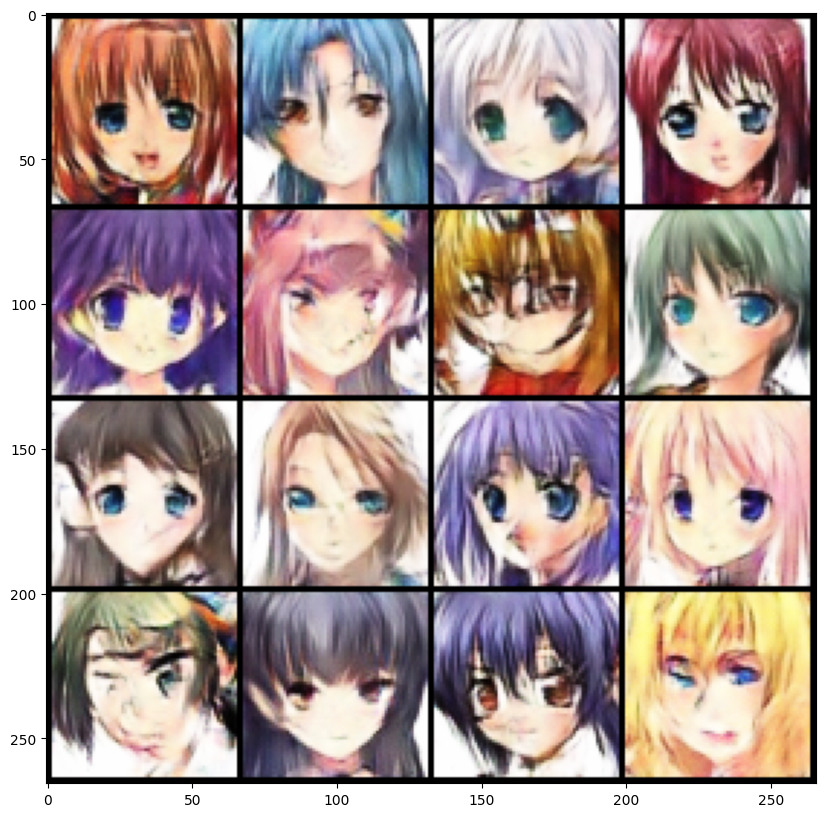

  0%|▏                                                                                 | 3/993 [00:00<01:34, 10.45it/s]

Epoch: 27 	 Disc_Loss: 0.02075352892279625 	 gen_Loss: 4.796988487243652


 10%|████████▎                                                                       | 103/993 [00:08<01:16, 11.60it/s]

Epoch: 27 	 Disc_Loss: 0.274850994348526 	 gen_Loss: 3.1730074882507324


 20%|████████████████▏                                                               | 201/993 [00:17<01:10, 11.26it/s]

Epoch: 27 	 Disc_Loss: 0.12593264877796173 	 gen_Loss: 2.0833191871643066


 31%|████████████████████████▍                                                       | 303/993 [00:25<00:59, 11.56it/s]

Epoch: 27 	 Disc_Loss: 0.044186677783727646 	 gen_Loss: 4.791707515716553


 41%|████████████████████████████████▍                                               | 403/993 [00:34<00:51, 11.44it/s]

Epoch: 27 	 Disc_Loss: 0.9169178009033203 	 gen_Loss: 9.942832946777344


 51%|████████████████████████████████████████▌                                       | 503/993 [00:42<00:43, 11.38it/s]

Epoch: 27 	 Disc_Loss: 0.04444748908281326 	 gen_Loss: 5.395791053771973


 61%|████████████████████████████████████████████████▌                               | 603/993 [00:51<00:33, 11.68it/s]

Epoch: 27 	 Disc_Loss: 0.08620141446590424 	 gen_Loss: 0.9494143724441528


 71%|████████████████████████████████████████████████████████▋                       | 703/993 [00:59<00:24, 11.60it/s]

Epoch: 27 	 Disc_Loss: 0.019712958484888077 	 gen_Loss: 4.654928684234619


 81%|████████████████████████████████████████████████████████████████▋               | 803/993 [01:08<00:16, 11.58it/s]

Epoch: 27 	 Disc_Loss: 0.056072898209095 	 gen_Loss: 3.62174391746521


 91%|████████████████████████████████████████████████████████████████████████▋       | 903/993 [01:16<00:07, 11.63it/s]

Epoch: 27 	 Disc_Loss: 0.025281336158514023 	 gen_Loss: 5.542270660400391


100%|████████████████████████████████████████████████████████████████████████████████| 993/993 [01:24<00:00, 11.76it/s]


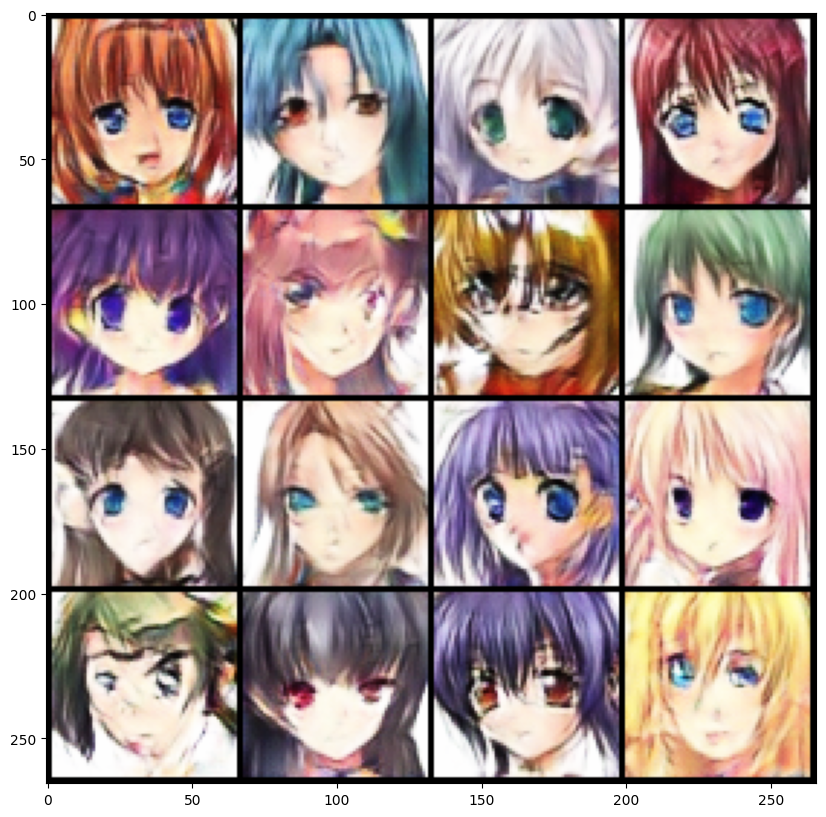

  0%|▏                                                                                 | 3/993 [00:00<01:35, 10.32it/s]

Epoch: 28 	 Disc_Loss: 0.012868275865912437 	 gen_Loss: 5.213237762451172


 10%|████████▎                                                                       | 103/993 [00:08<01:16, 11.59it/s]

Epoch: 28 	 Disc_Loss: 0.011749740689992905 	 gen_Loss: 5.534919261932373


 20%|████████████████▎                                                               | 203/993 [00:17<01:07, 11.65it/s]

Epoch: 28 	 Disc_Loss: 0.23283225297927856 	 gen_Loss: 4.02475118637085


 31%|████████████████████████▍                                                       | 303/993 [00:25<01:00, 11.50it/s]

Epoch: 28 	 Disc_Loss: 0.05362694337964058 	 gen_Loss: 5.472644805908203


 41%|████████████████████████████████▍                                               | 403/993 [00:34<00:50, 11.60it/s]

Epoch: 28 	 Disc_Loss: 0.01356526929885149 	 gen_Loss: 5.8364949226379395


 51%|████████████████████████████████████████▌                                       | 503/993 [00:42<00:42, 11.65it/s]

Epoch: 28 	 Disc_Loss: 0.03671446070075035 	 gen_Loss: 5.442487716674805


 61%|████████████████████████████████████████████████▌                               | 603/993 [00:51<00:33, 11.59it/s]

Epoch: 28 	 Disc_Loss: 0.0442802831530571 	 gen_Loss: 5.639663219451904


 71%|████████████████████████████████████████████████████████▋                       | 703/993 [00:59<00:25, 11.48it/s]

Epoch: 28 	 Disc_Loss: 0.04368423670530319 	 gen_Loss: 4.789801597595215


 81%|████████████████████████████████████████████████████████████████▋               | 803/993 [01:08<00:16, 11.54it/s]

Epoch: 28 	 Disc_Loss: 0.018811609596014023 	 gen_Loss: 4.9347333908081055


 91%|████████████████████████████████████████████████████████████████████████▋       | 903/993 [01:16<00:07, 11.59it/s]

Epoch: 28 	 Disc_Loss: 0.20499876141548157 	 gen_Loss: 2.759772300720215


100%|████████████████████████████████████████████████████████████████████████████████| 993/993 [01:24<00:00, 11.78it/s]


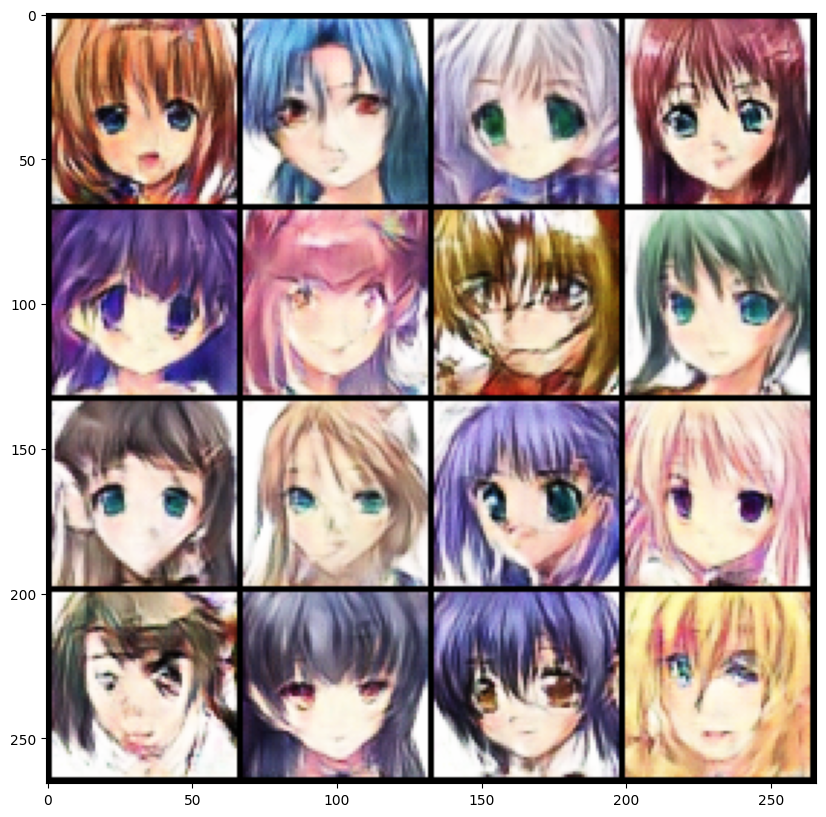

  0%|▏                                                                                 | 3/993 [00:00<01:34, 10.44it/s]

Epoch: 29 	 Disc_Loss: 0.3727387487888336 	 gen_Loss: 9.089349746704102


 10%|████████▎                                                                       | 103/993 [00:08<01:17, 11.47it/s]

Epoch: 29 	 Disc_Loss: 0.03017614036798477 	 gen_Loss: 5.598416805267334


 20%|████████████████▎                                                               | 203/993 [00:17<01:10, 11.26it/s]

Epoch: 29 	 Disc_Loss: 0.017033593729138374 	 gen_Loss: 4.82034969329834


 31%|████████████████████████▍                                                       | 303/993 [00:25<01:00, 11.33it/s]

Epoch: 29 	 Disc_Loss: 0.022258613258600235 	 gen_Loss: 4.6283087730407715


 41%|████████████████████████████████▍                                               | 403/993 [00:34<00:51, 11.53it/s]

Epoch: 29 	 Disc_Loss: 0.008802712894976139 	 gen_Loss: 5.5830397605896


 51%|████████████████████████████████████████▌                                       | 503/993 [00:42<00:42, 11.53it/s]

Epoch: 29 	 Disc_Loss: 0.03878993168473244 	 gen_Loss: 4.245697021484375


 61%|████████████████████████████████████████████████▌                               | 603/993 [00:51<00:34, 11.41it/s]

Epoch: 29 	 Disc_Loss: 0.07305194437503815 	 gen_Loss: 1.96504545211792


 71%|████████████████████████████████████████████████████████▋                       | 703/993 [00:59<00:25, 11.47it/s]

Epoch: 29 	 Disc_Loss: 0.02350839227437973 	 gen_Loss: 6.046205520629883


 81%|████████████████████████████████████████████████████████████████▋               | 803/993 [01:08<00:16, 11.59it/s]

Epoch: 29 	 Disc_Loss: 0.08006724715232849 	 gen_Loss: 5.170437812805176


 91%|████████████████████████████████████████████████████████████████████████▋       | 903/993 [01:16<00:07, 11.63it/s]

Epoch: 29 	 Disc_Loss: 0.04790303111076355 	 gen_Loss: 4.566715240478516


100%|████████████████████████████████████████████████████████████████████████████████| 993/993 [01:24<00:00, 11.77it/s]


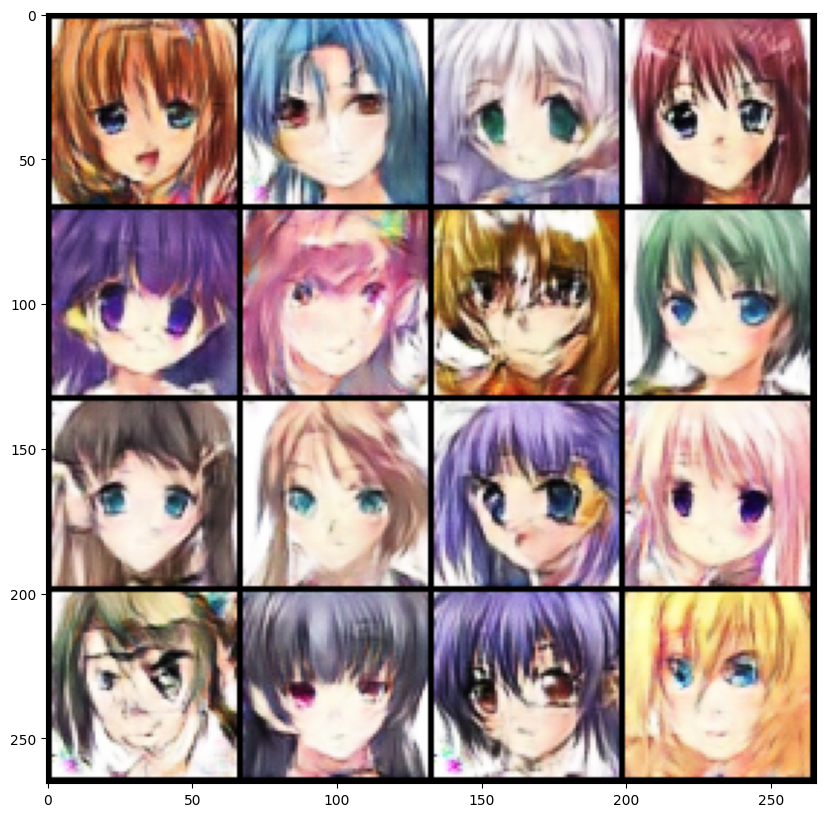

In [110]:
#train
gen.train()
disc.train()

for epoch in range(EPOCHS):
    for batch_idx, (real, _) in enumerate(tqdm(dataloader)):
        real = real.to(device)
        noise = torch.randn((BATCH_SIZE, z_dim, 1, 1)).to(device)
        fake = gen(noise)
        #train disc
        disc_real = disc(real).reshape(-1)
        loss_disc_real = loss(disc_real, torch.ones_like(disc_real))
        disc_fake = disc(fake).reshape(-1)
        loss_disc_fake = loss(disc_fake, torch.zeros_like(disc_fake))
        loss_disc = (loss_disc_real + loss_disc_fake) / 2
        disc.zero_grad()
        loss_disc.backward(retain_graph = True)
        disc_optimizer.step()

        #train gen
        noise = torch.randn((BATCH_SIZE, z_dim, 1, 1)).to(device)
        fake = gen(noise)
        output = disc(fake).reshape(-1)
        loss_gen = loss(output, torch.ones_like(output))
        gen.zero_grad()
        loss_gen.backward(retain_graph = True)
        gen_optimizer.step()

        if batch_idx % 100 == 0:
            print(f'Epoch: {epoch} \t Disc_Loss: {loss_disc} \t gen_Loss: {loss_gen}')
    with torch.no_grad():
        generated_images = gen(fixed_noise).cpu()
        grid = make_grid(generated_images, nrow=4, normalize=True, value_range=(-1, 1))
        plt.figure(figsize=(10, 10))
        plt.imshow(np.transpose(grid, (1, 2, 0)))
        plt.show()
        
        

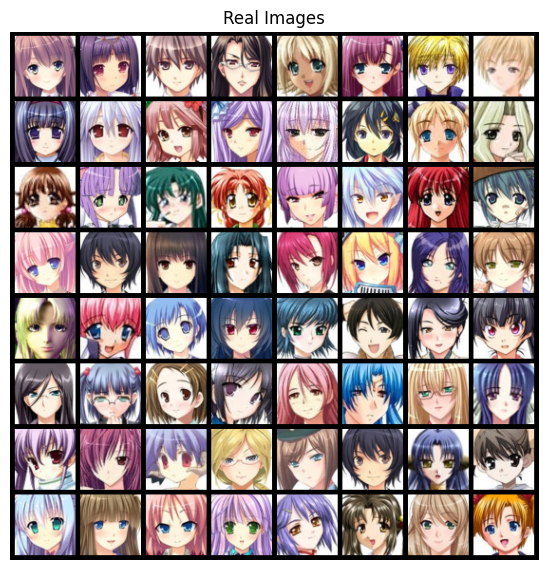

In [111]:
real_batch = next(iter(dataloader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))


In [112]:
noise = torch.randn((64, z_dim, 1, 1)).to(device)
with torch.no_grad():
    generated_images = gen(noise).cpu()

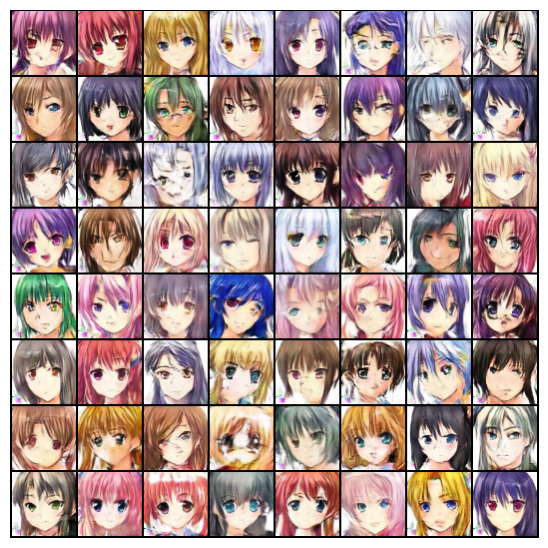

In [113]:
grid = make_grid(generated_images, nrow=8, normalize=True, value_range=(-1, 1))

plt.figure(figsize=(15, 15))
plt.subplot(1,2,1)
plt.axis("off")
plt.imshow(np.transpose(grid, (1, 2, 0)))
plt.show()

In [114]:
torch.save(gen.state_dict(), 'generator.pth')
torch.save(disc.state_dict(), 'discriminator.pth')

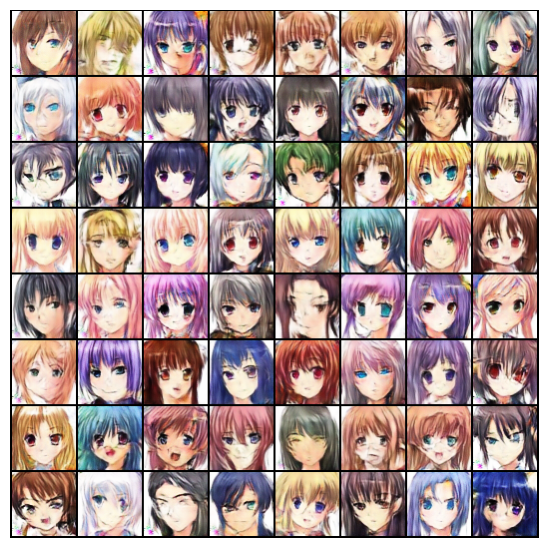

In [132]:
test = torch.randn((64, z_dim, 1, 1)).to(device)
with torch.no_grad():
    image = gen(test).cpu()

grid = make_grid(image, nrow=8, normalize=True, value_range=(-1, 1))

plt.figure(figsize=(15, 15))
plt.subplot(1,2,1)
plt.axis("off")
plt.imshow(np.transpose(grid, (1, 2, 0)))
plt.show()

In [23]:
generator = Generator(z_dim, IMG_SIZE, 3)
generator.load_state_dict(torch.load('generator.pth'))
generator.to(device)
generator.eval()

Generator(
  (generator): Sequential(
    (0): Sequential(
      (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
      (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU()
    )
    (1): Sequential(
      (0): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU()
    )
    (2): Sequential(
      (0): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU()
    )
    (3): Sequential(
      (0): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU()
    )
    (4): ConvTranspose2d(64, 3, 

In [26]:
test = torch.randn((128, z_dim, 1, 1)).to(device)
with torch.no_grad():
    images = generator(test).cpu()

In [28]:
preprocess = nn.Sequential(
    T.Resize((299, 299)),
)
processed_images = preprocess(images)
processed_images = (processed_images * 255).byte()

inception = InceptionScore()
inception_score = inception(processed_images)
inception_score

(tensor(2.0188), tensor(0.2684))